Author: Brook Tarekegn Assefa (rnc3mm)


In [1]:
from google.colab import drive

drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/

/content/drive/MyDrive


In [ ]:
!git clone https://github.com/brooksideas/weapon-detection-deep-learning.git

Cloning into 'weapon-detection-deep-learning'...
remote: Enumerating objects: 17575, done.
remote: Counting objects: 100% (5884/5884), done.
remote: Compressing objects: 100% (5176/5176), done.
remote: Total 17575 (delta 11), reused 5837 (delta 4), pack-reused 11691
Receiving objects: 100% (17575/17575), 405.20 MiB | 5.03 MiB/s, done.
Resolving deltas: 100% (12/12), done.
Updating files: 100% (11725/11725), done.


### DETR Minimal Implementation


#### Path to datasets


In [ ]:
dataset_path = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data"

In [ ]:
from PIL import Image
import requests
import os
import matplotlib.pyplot as plt
%config InlineBackend.figure_format = 'retina'

import torch
from torch import nn
from torchvision.models import resnet50
import torchvision.transforms as T
torch.set_grad_enabled(False);

### A minimal implementation of DETR:


In [ ]:
class DETRdemo(nn.Module):
    """
    Demo DETR implementation.

    Demo implementation of DETR in minimal number of lines, with the
    following differences wrt DETR in the paper:
    * learned positional encoding (instead of sine)
    * positional encoding is passed at input (instead of attention)
    * fc bbox predictor (instead of MLP)
    The model achieves ~40 AP on COCO val5k and runs at ~28 FPS on Tesla V100.
    Only batch size 1 supported.
    """

    def __init__(
        self,
        num_classes,
        hidden_dim=256,
        nheads=8,
        num_encoder_layers=6,
        num_decoder_layers=6,
    ):
        super().__init__()

        # create ResNet-50 backbone
        self.backbone = resnet50()
        del self.backbone.fc

        # create conversion layer
        self.conv = nn.Conv2d(2048, hidden_dim, 1)

        # create a default PyTorch transformer
        self.transformer = nn.Transformer(
            hidden_dim, nheads, num_encoder_layers, num_decoder_layers
        )

        # prediction heads, one extra class for predicting non-empty slots
        # note that in baseline DETR linear_bbox layer is 3-layer MLP
        self.linear_class = nn.Linear(hidden_dim, num_classes + 1)
        self.linear_bbox = nn.Linear(hidden_dim, 4)

        # output positional encodings (object queries)
        self.query_pos = nn.Parameter(torch.rand(100, hidden_dim))

        # spatial positional encodings
        # note that in baseline DETR we use sine positional encodings
        self.row_embed = nn.Parameter(torch.rand(50, hidden_dim // 2))
        self.col_embed = nn.Parameter(torch.rand(50, hidden_dim // 2))

    def forward(self, inputs):
        # propagate inputs through ResNet-50 up to avg-pool layer
        x = self.backbone.conv1(inputs)
        x = self.backbone.bn1(x)
        x = self.backbone.relu(x)
        x = self.backbone.maxpool(x)

        x = self.backbone.layer1(x)
        x = self.backbone.layer2(x)
        x = self.backbone.layer3(x)
        x = self.backbone.layer4(x)

        # convert from 2048 to 256 feature planes for the transformer
        h = self.conv(x)

        # construct positional encodings
        H, W = h.shape[-2:]
        pos = (
            torch.cat(
                [
                    self.col_embed[:W].unsqueeze(0).repeat(H, 1, 1),
                    self.row_embed[:H].unsqueeze(1).repeat(1, W, 1),
                ],
                dim=-1,
            )
            .flatten(0, 1)
            .unsqueeze(1)
        )

        # propagate through the transformer
        h = self.transformer(
            pos + 0.1 * h.flatten(2).permute(2, 0, 1), self.query_pos.unsqueeze(1)
        ).transpose(0, 1)

        # finally project transformer outputs to class labels and bounding boxes
        return {
            "pred_logits": self.linear_class(h),
            "pred_boxes": self.linear_bbox(h).sigmoid(),
        }

#### Download the Model


In [ ]:
detr = DETRdemo(num_classes=91)
state_dict = torch.hub.load_state_dict_from_url(
    url="https://dl.fbaipublicfiles.com/detr/detr_demo-da2a99e9.pth",
    map_location="cpu",
    check_hash=True,
)
detr.load_state_dict(state_dict)
detr.eval()

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")
Downloading: "https://dl.fbaipublicfiles.com/detr/detr_demo-da2a99e9.pth" to /root/.cache/torch/hub/checkpoints/detr_demo-da2a99e9.pth
100%|██████████| 79.3M/79.3M [00:00<00:00, 92.8MB/s]


#### Computing predictions with DETR


In [ ]:
# COCO classes
CLASSES = [
    "N/A",
    "person",
    "bicycle",
    "car",
    "motorcycle",
    "airplane",
    "bus",
    "train",
    "truck",
    "boat",
    "traffic light",
    "fire hydrant",
    "N/A",
    "stop sign",
    "parking meter",
    "bench",
    "bird",
    "cat",
    "dog",
    "horse",
    "sheep",
    "cow",
    "elephant",
    "bear",
    "zebra",
    "giraffe",
    "N/A",
    "backpack",
    "umbrella",
    "N/A",
    "N/A",
    "handbag",
    "tie",
    "suitcase",
    "frisbee",
    "skis",
    "snowboard",
    "sports ball",
    "kite",
    "baseball bat",
    "baseball glove",
    "skateboard",
    "surfboard",
    "tennis racket",
    "bottle",
    "N/A",
    "wine glass",
    "cup",
    "fork",
    "knife",
    "spoon",
    "bowl",
    "banana",
    "apple",
    "sandwich",
    "orange",
    "broccoli",
    "carrot",
    "hot dog",
    "pizza",
    "donut",
    "cake",
    "chair",
    "couch",
    "potted plant",
    "bed",
    "N/A",
    "dining table",
    "N/A",
    "N/A",
    "toilet",
    "N/A",
    "tv",
    "laptop",
    "mouse",
    "remote",
    "keyboard",
    "cell phone",
    "microwave",
    "oven",
    "toaster",
    "sink",
    "refrigerator",
    "N/A",
    "book",
    "clock",
    "vase",
    "scissors",
    "teddy bear",
    "hair drier",
    "toothbrush",
]

# colors for visualization
COLORS = [
    [0.000, 0.447, 0.741],
    [0.850, 0.325, 0.098],
    [0.929, 0.694, 0.125],
    [0.494, 0.184, 0.556],
    [0.466, 0.674, 0.188],
    [0.301, 0.745, 0.933],
]

#### Using ImageNet


In [ ]:
# standard PyTorch mean-std input image normalization
transform = T.Compose(
    [
        T.Resize(800),
        T.ToTensor(),
        T.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225]),
    ]
)


# for output bounding box post-processing
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h), (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)


def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

#### Detect function


In [ ]:
def detect(im, model, transform):
    # mean-std normalize the input image (batch-size: 1)
    img = transform(im).unsqueeze(0)

    # demo model only support by default images with aspect ratio between 0.5 and 2
    # if you want to use images with an aspect ratio outside this range
    # rescale your image so that the maximum size is at most 1333 for best results
    assert (
        img.shape[-2] <= 1600 and img.shape[-1] <= 1600
    ), "demo model only supports images up to 1600 pixels on each side"

    # propagate through the model
    outputs = model(img)

    # keep only predictions with 0.7+ confidence
    probas = outputs["pred_logits"].softmax(-1)[0, :, :-1]
    keep = probas.max(-1).values > 0.7

    # convert boxes from [0; 1] to image scales
    bboxes_scaled = rescale_bboxes(outputs["pred_boxes"][0, keep], im.size)
    return probas[keep], bboxes_scaled

#### Using DETR


In [ ]:
# url = 'http://images.cocodataset.org/val2017/000000039769.jpg'
url = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/images/test/ABbframe00145.jpg"
# url = os.path.join(dataset_path , '' )
# print(url)
# im = Image.open(requests.get(url, stream=True).raw)

# Open the image directly from the file path
im = Image.open(url)

scores, boxes = detect(im, detr, transform)

#### Visualization


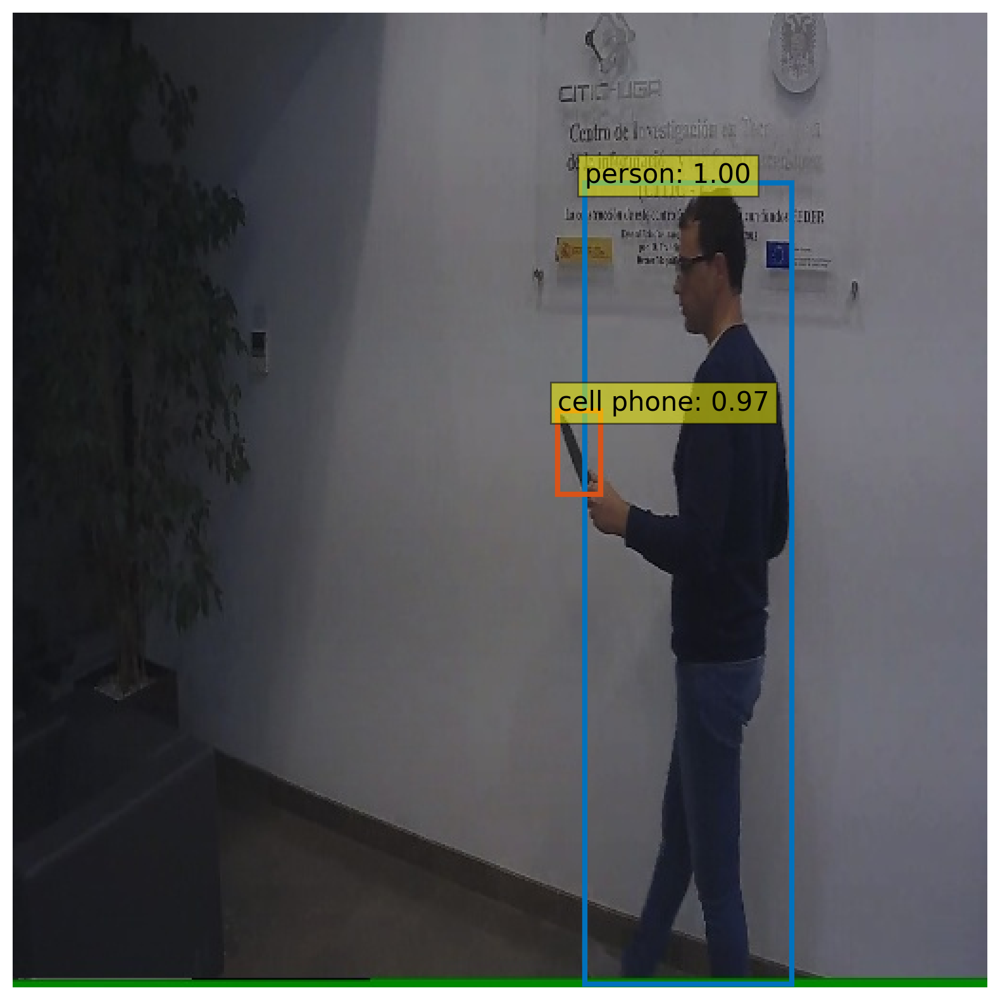

In [ ]:
def plot_results(pil_img, prob, boxes):
    plt.figure(figsize=(16, 10))
    plt.imshow(pil_img)
    ax = plt.gca()
    for p, (xmin, ymin, xmax, ymax), c in zip(prob, boxes.tolist(), COLORS * 100):
        ax.add_patch(
            plt.Rectangle(
                (xmin, ymin), xmax - xmin, ymax - ymin, fill=False, color=c, linewidth=3
            )
        )
        cl = p.argmax()
        text = f"{CLASSES[cl]}: {p[cl]:0.2f}"
        ax.text(xmin, ymin, text, fontsize=15, bbox=dict(facecolor="yellow", alpha=0.5))
    plt.axis("off")
    plt.show()


plot_results(im, scores, boxes)

# DETR FULL


# cloning github repo of detr to import its unique loss


In [ ]:
!git clone https://github.com/facebookresearch/detr.git

Cloning into 'detr'...
remote: Enumerating objects: 263, done.
remote: Total 263 (delta 0), reused 0 (delta 0), pack-reused 263
Receiving objects: 100% (263/263), 12.88 MiB | 3.79 MiB/s, done.
Resolving deltas: 100% (122/122), done.


In [ ]:
print(os.listdir("/content/drive/MyDrive/detr/models/"))

['__init__.py', 'backbone.py', 'detr.py', 'position_encoding.py', 'segmentation.py', 'transformer.py', '__pycache__', 'matcher.py']


In [ ]:
!pip show torch

Name: torch
Version: 2.1.0+cu118
Summary: Tensors and Dynamic neural networks in Python with strong GPU acceleration
Home-page: https://pytorch.org/
Author: PyTorch Team
Author-email: packages@pytorch.org
License: BSD-3
Location: /usr/local/lib/python3.10/dist-packages
Requires: filelock, fsspec, jinja2, networkx, sympy, triton, typing-extensions
Required-by: fastai, torchaudio, torchdata, torchtext, torchvision


In [3]:
import os
import numpy as np
import pandas as pd
from datetime import datetime
import time
import random
import requests
import matplotlib.pyplot as plt
from tqdm.autonotebook import tqdm
from PIL import Image, ImageDraw, ImageFont


# Torch
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torch.utils.data.sampler import SequentialSampler, RandomSampler
from torch.utils.data import Dataset
import torchvision.transforms as transforms

# Tensorflow
import tensorflow as tf

# Keras
import keras
from keras.preprocessing.image import load_img


# sklearn
from sklearn.model_selection import StratifiedKFold

# CV
import cv2

################# DETR FUCNTIONS FOR LOSS########################
import sys

sys.path.append("/content/drive/MyDrive/detr")
import detr
from detr.models.detr import MLP
from detr.models.backbone import build_backbone
from detr.models.transformer import build_transformer
from detr.models.matcher import HungarianMatcher
from detr.models.detr import SetCriterion
from detr.util.misc import nested_tensor_from_tensor_list

#################################################################

# Albumenatations
import albumentations as Album
import matplotlib.pyplot as plt
from albumentations.pytorch.transforms import ToTensorV2
from albumentations.core.bbox_utils import denormalize_bboxes

# Glob
from glob import glob

# GRAD CAM
from IPython.display import Image, display
import matplotlib as mpl
import matplotlib.pyplot as plt

### Helper function

#### AverageMeter - class for averaging loss,metric,etc over epochs


In [90]:
class AverageMeter(object):
    """Computes and stores the average and current value"""

    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

### Configuration

#### Basic configuration for this model


In [91]:
n_folds = 5
seed = 3
num_classes = 6
num_queries = 100
null_class_coef = 0.5
BATCH_SIZE = 8
LR = 2e-5
EPOCHS = 2
class_names = ["pistol", "smartphone", "knife", "monedero", "billete", "tarjeta"]
category_id_to_names = {
    0: "pistol",
    1: "smartphone",
    2: "knife",
    3: "monedero",
    4: "billete",
    5: "tarjeta",
}

### Initialize Seed


In [92]:
def initialize_seed(seed):
    random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = True

In [93]:
initialize_seed(seed)

### Create the Weapon Detection Dataset


In [94]:
class WeaponDataset(Dataset):
    def __init__(self, image_url, label_url, class_names, transform=None):
        self.image_url = image_url
        self.label_url = label_url
        self.class_names = class_names
        self.image_files = sorted(
            [f for f in os.listdir(image_url) if f.endswith((".jpg", ".JPG", "jpeg"))]
        )
        self.label_files = sorted(
            [f for f in os.listdir(label_url) if f.endswith(".txt")]
        )
        self.transform = transform

    def __len__(self):
        return len(self.image_files)
        train_dataset.__setitem__(
            sample_index, sharpness_transformed_image["image"], sample_target
        )

    def __getitem__(self, idx):
        image_name = self.image_files[idx]
        label_name = self.label_files[idx]

        # Load image
        img_path = os.path.join(self.image_url, image_name)
        image = cv2.imread(img_path, cv2.IMREAD_COLOR)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32) / 255.0

        # Load labels
        label_path = os.path.join(self.label_url, label_name)
        with open(label_path, "r") as f:
            label_content = f.readline().strip().split()

        # Extracting bounding box coordinates
        boxes = torch.tensor(list(map(float, label_content[1:])), dtype=torch.float32)

        # Convert label to integer
        label_index = int(label_content[0])

        if self.transform:
            sample = {"image": image, "bboxes": boxes, "labels": label_index}
            sample = self.transform(**sample)
            image = sample["image"]
            boxes = sample["bboxes"]

        # Set the precision for printing tensor values
        torch.set_printoptions(precision=15)

        target = {
            "boxes": boxes.view(-1, 4),
            "labels": torch.tensor([label_index], dtype=torch.int64),
        }

        # Reset the precision to default after creating the target
        torch.set_printoptions(precision=8)

        return image, target, image_name

#### Plot a bounding Box to see if out Custom Dataset Creation works as expected


In [96]:
url_train_images = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/images/train/"
url_train_labels = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/labels/train/"

10275


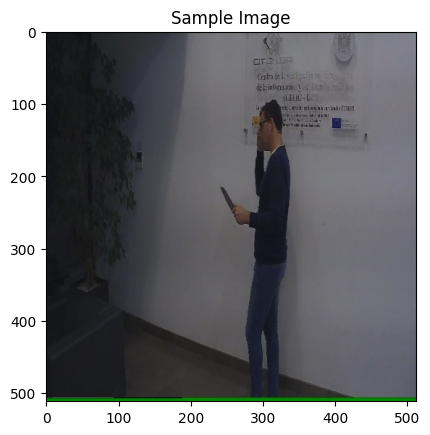

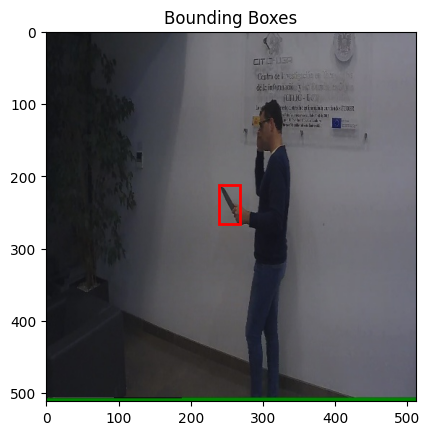

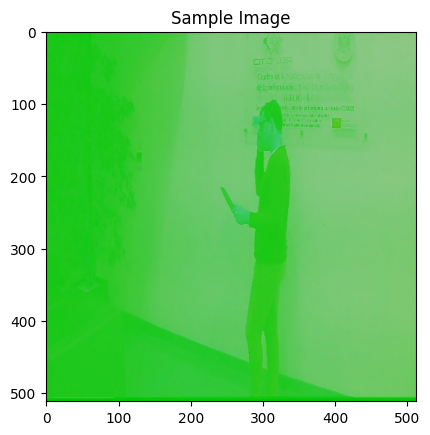

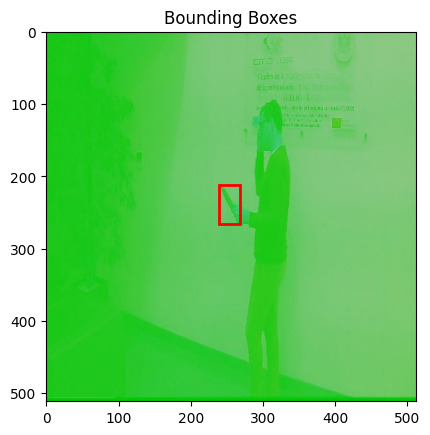

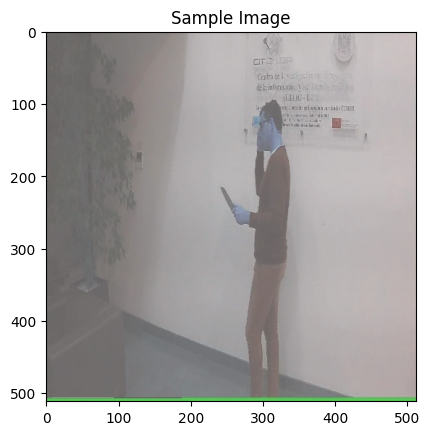

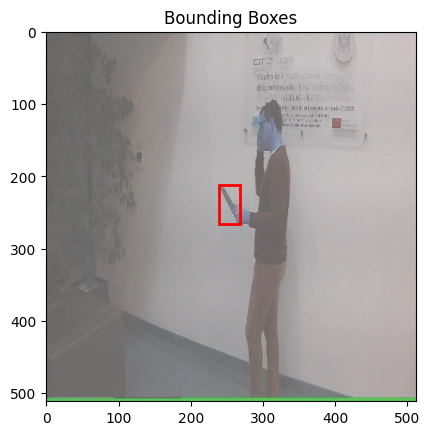

In [ ]:
# URL for train images and labels
url_train_images = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/images/train/"
url_train_labels = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/labels/train/"

# Create an instance of the WeaponDataset
train_dataset = WeaponDataset(url_train_images, url_train_labels, class_names)
print(len(train_dataset))

# Choose a 3 sample index to visualize
for x in range(3):
    sample_index = x
    # Get the sample
    sample_image, sample_target, _ = train_dataset[sample_index]

    # Visualize the image
    plt.imshow(sample_image)
    plt.title("Sample Image")
    plt.show()

    # Visualize the bounding boxes
    plt.imshow(sample_image)
    for i, box in enumerate(sample_target["boxes"]):
        x, y, w, h = box.numpy()

        # Denormalize coordinates based on the normalization process in WeaponDataset
        x = int((x - w / 2) * sample_image.shape[0])
        y = int((y - h / 2) * sample_image.shape[1])
        w *= sample_image.shape[0]  # Equal W x H 512 x 512
        h *= sample_image.shape[1]

        plt.gca().add_patch(
            plt.Rectangle((x, y), w, h, fill=False, edgecolor="r", linewidth=2)
        )

    plt.title("Bounding Boxes")
    plt.show()

### Create the DETR Model


In [10]:
class DETRModel(nn.Module):
    def __init__(self, num_classes, num_queries):
        super(DETRModel, self).__init__()
        self.num_classes = num_classes
        self.num_queries = num_queries

        self.model = torch.hub.load(
            "facebookresearch/detr", "detr_resnet50", pretrained=True
        )
        self.in_features = self.model.class_embed.in_features

        self.model.class_embed = nn.Linear(
            in_features=self.in_features, out_features=self.num_classes
        )
        self.model.num_queries = self.num_queries
        self.model.requires_grad_()

    def forward(self, images):
        # Extract the weights before the forward pass
        weights = self.model.state_dict()

        # Perform the forward pass
        output = self.model(images)

        return output, weights

#### Matcher and Bipartite Matching Loss

**DETR calcuates three individual losses:**

- _Classification Loss for labels(its weight can be set by loss_ce):_
  - penalizes the model more when the predicted probability distribution diverges from the true distribution.
- _Bbox Loss (its weight can be set by loss_bbox):_
  - measures the difference between the predicted bounding box coordinates and the ground truth coordinates.
- _Loss for Background class:_
  - to penalize deviations from the true background class distribution.


In [97]:
"""
code taken from github repo detr , 'code present in engine.py'
"""

matcher = HungarianMatcher()

weight_dict = {"loss_ce": 1, "loss_bbox": 1, "loss_giou": 1}

losses = ["labels", "boxes", "cardinality"]

#### Training Function ( we train the criterion as well)


In [98]:
def train_fn(data_loader, model, criterion, optimizer, device, scheduler, epoch):
    # Sets the model to training mode, enabling features like dropout.
    model.train()

    # Sets the criterion (loss function) to training mode
    criterion.train()

    # track of the average loss during training
    summary_loss = AverageMeter()

    # bar for visualization during training.
    tk0 = tqdm(data_loader, total=len(data_loader))

    for step, (images, targets, image_names) in enumerate(tk0):
        # Convert images and targets to Tensor and move to device
        images = [torch.from_numpy(image).to(device) for image in images]

        targets = [
            {k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets
        ]

        # Assuming images is the first element in the tuple
        images = torch.stack(images)  # Stack the images to form a batch
        images = images.permute(0, 3, 1, 2)  # Permute dimensions to [8, 3, 512, 512]

        for i, image in enumerate(images):
            image.requires_grad_()  # Start Recording for Back prop

        # Use the entire batch as input to the model
        output, weights = model(images)

        #  calculate by matcher and bipartite matching loss
        loss_dict = criterion(output, targets)

        # Retrieves the weight dictionary associated with the criterion.
        weight_dict = criterion.weight_dict

        #  Computes the total loss
        losses = sum(
            loss_dict[k] * weight_dict[k] for k in loss_dict.keys() if k in weight_dict
        )

        # {'loss_ce': tensor(2.56807137, device='cuda:0'), 'class_error': tensor(75., device='cuda:0'), 'loss_bbox': tensor(0.27899978, device='cuda:0'), 'loss_giou': tensor(0.56966877, device='cuda:0'), 'cardinality_error': tensor(99., device='cuda:0')}
        optimizer.zero_grad()

        print("Training Losses ===>", losses)

        losses.backward()

        # Updates model parameters based on gradients.
        optimizer.step()

        # adjusts the learning rate using a scheduler
        if scheduler is not None:
            scheduler.step()

        summary_loss.update(losses.item(), BATCH_SIZE)
        tk0.set_postfix(loss=summary_loss.avg)

    return summary_loss

#### Evaluation Function


In [99]:
def eval_fn(data_loader, model, criterion, device):
    # Set the model and criterion to evaluation mode
    model.eval()
    criterion.eval()

    # Initialize an AverageMeter to keep track of the average loss
    summary_loss = AverageMeter()

    # Disable gradient computation during evaluation
    with torch.no_grad():
        # Initialize a tqdm progress bar for visualization
        tk0 = tqdm(data_loader, total=len(data_loader))
        # Iterate over batches in the data loader
        for step, (images, targets, image_names) in enumerate(tk0):
            # Move images and targets to the specified device
            images = [torch.from_numpy(image).to(device) for image in images]
            targets = [
                {k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets
            ]

            # Assuming images is the first element in the tuple
            images = torch.stack(images)  # Stack the images to form a batch
            images = images.permute(
                0, 3, 1, 2
            )  # Permute dimensions to [8, 3, 512, 512]

            for i, image in enumerate(images):
                image.requires_grad_()  # Start Recording for Back prop

            # Forward pass to obtain model predictions
            output, _ = model(images)

            # Calculate losses using the specified criterion
            loss_dict = criterion(output, targets)
            # Retrieve the weight dictionary associated with the criterion
            weight_dict = criterion.weight_dict

            # Compute the total loss, taking into account individual losses and their weights
            losses = sum(
                loss_dict[k] * weight_dict[k]
                for k in loss_dict.keys()
                if k in weight_dict
            )

            print("Validation Losses ===>", losses)

            # Update the average loss
            summary_loss.update(losses.item(), BATCH_SIZE)
            # Update the tqdm progress bar with the current average loss
            tk0.set_postfix(loss=summary_loss.avg)

    # Return the summary loss
    return summary_loss

#### Training using DETR


In [100]:
def collate_fn(batch):
    return tuple(zip(*batch))

In [101]:
from tensorflow.python.client import device_lib

# Get the list of available devices
local_device_protos = device_lib.list_local_devices()

# Filter out the GPUs
gpu_devices = [x.name for x in local_device_protos if x.device_type == "GPU"]

if gpu_devices:
    print("Available GPU devices:", gpu_devices)
else:
    print("No GPU devices available.")

No GPU devices available.


#### The Run Function to trigger the Training and Evaluation Loop

#### _Note: Works with torch version v2.0.0 , the latest google collab v2.1.0 breaks on autograd's grad_fn_


In [ ]:
def run():
    # Use your dataset without folds
    weapon_dataset = WeaponDataset(
        image_url=url_train_images, label_url=url_train_labels, class_names=class_names
    )

    # Split the dataset into training and validation sets (adjust the ratio if needed)
    total_samples = len(weapon_dataset)
    train_size = int(0.8 * total_samples)
    val_size = total_samples - train_size

    train_dataset, val_dataset = torch.utils.data.random_split(
        weapon_dataset,
        [train_size, val_size],
        generator=torch.Generator().manual_seed(seed),  # Set a seed for reproducibility
    )

    train_data_loader = DataLoader(
        train_dataset,
        batch_size=BATCH_SIZE,
        shuffle=True,
        num_workers=4,
        collate_fn=collate_fn,
    )

    valid_data_loader = DataLoader(
        val_dataset,
        batch_size=BATCH_SIZE,
        shuffle=False,
        num_workers=4,
        collate_fn=collate_fn,
    )

    device = torch.device("cpu")  # torch.device("cuda:0")
    model = DETRModel(num_classes=num_classes, num_queries=num_queries)
    model = model.to(device)
    criterion = SetCriterion(
        num_classes - 1, matcher, weight_dict, eos_coef=null_class_coef, losses=losses
    )
    criterion = criterion.to(device)

    optimizer = torch.optim.AdamW(model.parameters(), lr=LR)

    best_loss = 10**5

    # Save a Model on this Path
    saved_model_path = "/content/drive/MyDrive/saved-models"

    for epoch in range(EPOCHS):
        train_loss = train_fn(
            train_data_loader,
            model,
            criterion,
            optimizer,
            device,
            scheduler=None,
            epoch=epoch,
        )
        valid_loss = eval_fn(valid_data_loader, model, criterion, device)

        print(
            "|EPOCH {}| TRAIN_LOSS {}| VALID_LOSS {}|".format(
                epoch + 1, train_loss.avg, valid_loss.avg
            )
        )

        if valid_loss.avg < best_loss:
            best_loss = valid_loss.avg
            print("Best model found in Epoch {}........Saving Model".format(epoch + 1))
            torch.save(
                model.state_dict(),
                f"{saved_model_path}/detr_best_no_transformation.pth",
            )

### Run


In [ ]:
print(torch.__version__)

2.0.0+cu117


In [ ]:
run()

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:561: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equi

  0%|          | 0/499 [00:00<?, ?it/s]

<ipython-input-19-230e667be549>:19: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  targets = [{k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets]


Training Losses ===> tensor(2.3292, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.7711, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.8640, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.4572, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5809, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.7063, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.4268, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5866, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.2482, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5686, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.2307, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.4922, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.3616, device='cuda:0', grad_fn=<AddBackward0>)

  0%|          | 0/125 [00:00<?, ?it/s]

<ipython-input-20-e58adb034215>:17: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  targets = [{k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets]


Validation Losses ===> tensor(1.0634, device='cuda:0')
Validation Losses ===> tensor(0.8448, device='cuda:0')
Validation Losses ===> tensor(0.9360, device='cuda:0')
Validation Losses ===> tensor(1.2205, device='cuda:0')
Validation Losses ===> tensor(1.1551, device='cuda:0')
Validation Losses ===> tensor(0.7713, device='cuda:0')
Validation Losses ===> tensor(0.8546, device='cuda:0')
Validation Losses ===> tensor(0.9566, device='cuda:0')
Validation Losses ===> tensor(0.9639, device='cuda:0')
Validation Losses ===> tensor(1.2157, device='cuda:0')
Validation Losses ===> tensor(0.6930, device='cuda:0')
Validation Losses ===> tensor(0.8445, device='cuda:0')
Validation Losses ===> tensor(0.9932, device='cuda:0')
Validation Losses ===> tensor(1.0500, device='cuda:0')
Validation Losses ===> tensor(1.0785, device='cuda:0')
Validation Losses ===> tensor(0.7827, device='cuda:0')
Validation Losses ===> tensor(1.1485, device='cuda:0')
Validation Losses ===> tensor(0.8107, device='cuda:0')
Validation

  0%|          | 0/499 [00:00<?, ?it/s]

Training Losses ===> tensor(0.5939, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.7625, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.0646, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.9666, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.8453, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.7822, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.8104, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.0041, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.0209, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.8049, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.8747, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.9865, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.7026, device='cuda:0', grad_fn=<AddBackward0>)

  0%|          | 0/125 [00:00<?, ?it/s]

Validation Losses ===> tensor(0.7242, device='cuda:0')
Validation Losses ===> tensor(0.8032, device='cuda:0')
Validation Losses ===> tensor(0.7648, device='cuda:0')
Validation Losses ===> tensor(0.7899, device='cuda:0')
Validation Losses ===> tensor(0.8345, device='cuda:0')
Validation Losses ===> tensor(0.7434, device='cuda:0')
Validation Losses ===> tensor(0.8444, device='cuda:0')
Validation Losses ===> tensor(0.7261, device='cuda:0')
Validation Losses ===> tensor(0.8816, device='cuda:0')
Validation Losses ===> tensor(1.0058, device='cuda:0')
Validation Losses ===> tensor(0.5851, device='cuda:0')
Validation Losses ===> tensor(0.6932, device='cuda:0')
Validation Losses ===> tensor(0.8333, device='cuda:0')
Validation Losses ===> tensor(0.8402, device='cuda:0')
Validation Losses ===> tensor(0.8014, device='cuda:0')
Validation Losses ===> tensor(0.7904, device='cuda:0')
Validation Losses ===> tensor(0.8170, device='cuda:0')
Validation Losses ===> tensor(0.5541, device='cuda:0')
Validation

### Check the performance of the Model with One Image


In [ ]:
print(Album.__version__)

1.3.1


#### The Image we are going to predict and plot the Bounding Box over


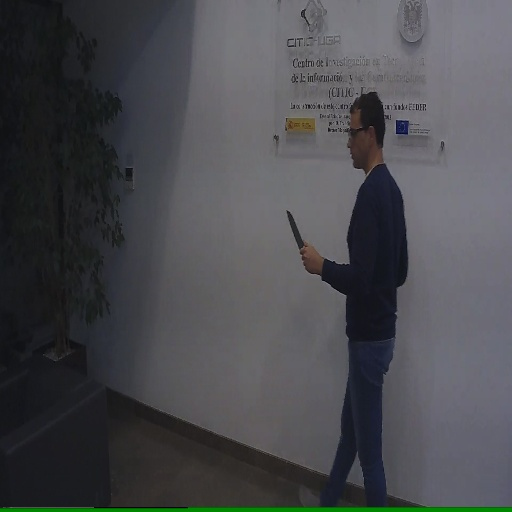

In [ ]:
path_test_image = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/images/test/ABbframe00145.jpg"
sample_image = Image.open(path_test_image)
sample_image

#### Prediction Function that runs on the given sample image


In [102]:
def view_sample(model, device):
    """
    Check Model perfomance on a Single Image file
    """
    # Using our dataset
    valid_dataset = WeaponDataset(
        image_url=url_train_images, label_url=url_train_labels, class_names=class_names
    )

    valid_data_loader = DataLoader(
        valid_dataset,
        batch_size=BATCH_SIZE,
        shuffle=False,
        num_workers=4,
        collate_fn=collate_fn,
    )

    # Get the value using the data loader
    images, targets, image_names = next(iter(valid_data_loader))
    _, h, w = images[0].shape  # for de-normalizing images

    # Convert images and targets to Tensor and move to device
    images = [torch.from_numpy(image).to(device) for image in images]

    images = torch.stack(images)  # Stack the images to form a batch
    images = images.permute(0, 3, 1, 2)  # Permute dimensions to [8, 3, 512, 512]

    # Targets to extract boxes and labels
    targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

    boxes = targets[0]["boxes"].cpu().numpy()

    boxes = [np.array(box).astype(np.int32) for box in denormalize_bboxes(boxes, h, w)]
    sample = images[0].permute(1, 2, 0).cpu().numpy()

    model.eval()
    model.to(device)
    cpu_device = torch.device("cpu")

    with torch.no_grad():
        outputs = model(images)

    outputs = {k: v.to(cpu_device) for k, v in outputs[0].items()}

    # Draw the Bounding Box on the Image
    drw = ImageDraw.Draw(sample_image)

    pred_logits = outputs["pred_logits"][0][:, : len(class_names)]
    pred_boxes = outputs["pred_boxes"][0]

    max_output = pred_logits.softmax(-1).max(-1)
    topk = max_output.values.topk(1)

    pred_logits = pred_logits[topk.indices]
    pred_boxes = pred_boxes[topk.indices]

    for logits, box in zip(pred_logits, pred_boxes):
        cls = logits.argmax()
        if cls >= len(class_names):
            continue
        # Note: For Demo purposes I am resorting to the Target label instead of the Predicted
        # because the Model kept on missing the labels
        label = class_names[targets[0]["labels"]]  # class_names[cls]
        box = box.cpu() * torch.Tensor([512, 512, 256, 256])
        x, y, w, h = box
        x0, x1 = x - w // 2, x + w // 2
        y0, y1 = y - h // 2, y + w // 2
        # It only takes the Top 1 , or the best prediction
        drw.rectangle([x0, y0, x1, y1], outline="red", width=5)
        drw.text((x, y), label, fill="white")

In [ ]:
# When using CPU :(
saved_detr_with_no_transformation_model_path = (
    "/content/drive/MyDrive/saved-models/detr_best_no_transformation.pth"
)
model = DETRModel(num_classes=num_classes, num_queries=num_queries)

# Load the model parameters and map them to the CPU
checkpoint = torch.load(
    saved_detr_with_no_transformation_model_path, map_location=torch.device("cpu")
)
model.load_state_dict(checkpoint)

# Move the model to the desired device (CPU or GPU)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
model.to(device)

# Continue with the rest of your code
view_sample(model=model, device=device)

Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


#### Draw the Bounding Box Over the Image


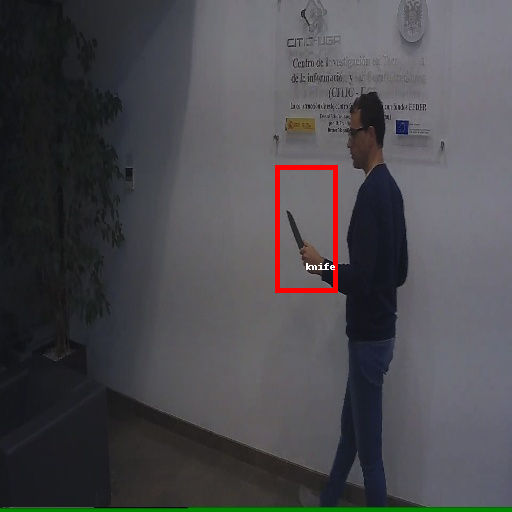

In [ ]:
sample_image

In [ ]:
# When the GPU is available
saved_detr_with_no_transformation_model_path = (
    "/content/drive/MyDrive/saved-models/detr_best_no_transformation.pth"
)
model = DETRModel(num_classes=num_classes, num_queries=num_queries)
model.load_state_dict(torch.load(saved_detr_with_no_transformation_model_path))
view_sample(model=model, device=torch.device("cuda"))

### Augmentation


In [ ]:
def apply_colormap(image, colormap):
    """Apply a colormap to an image."""
    # Normalize the image values to the range [0, 1]
    image = image / np.max(image)

    # Apply the colormap to the normalized image
    mapped_image = colormap(image)

    # Convert the mapped image to uint8 format for display
    mapped_image = np.uint8(mapped_image * 255)

    return mapped_image

(512, 512, 3)


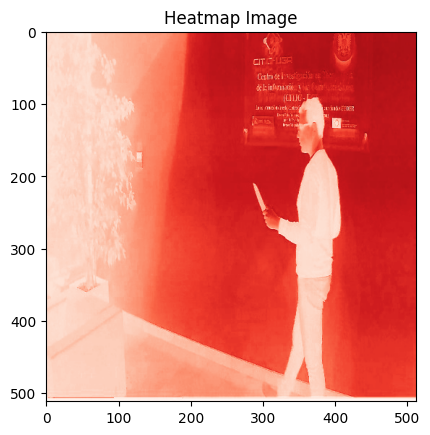

In [ ]:
from keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt

# Load the image
path_test_image = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/images/test/ABbframe00145.jpg"
img = load_img(path_test_image)

# Convert the image to a NumPy array
data = img_to_array(img)

# Extract red channel
red_channel = data[:, :, 0]

# Apply a custom red colormap
custom_cmap = plt.cm.Reds
print(data.shape)

# Generate a heatmap-like image with red emphasis
heatmap_image = apply_colormap(red_channel, custom_cmap)


plt.imshow(heatmap_image)
plt.title("Heatmap Image")
plt.show()

#### 1. Augmentation to Cover all the X-ray Like Images Points


#### We are looking to cover this type of Images


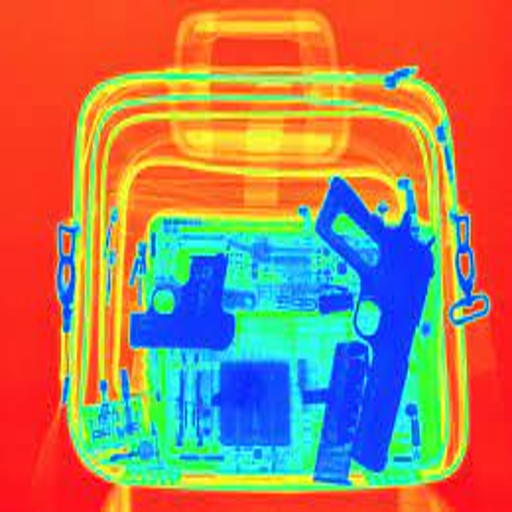

In [ ]:
img = Image.open(requests.get(url, stream=True).raw).resize((512, 512)).convert("RGB")
img

#### Augmentation to Inferno (RED Dominant)


(512, 512, 3)


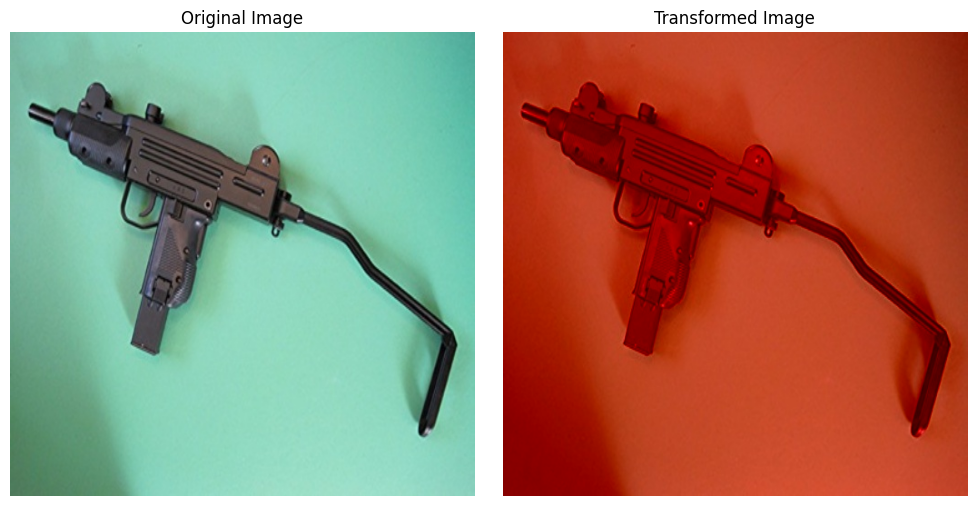

In [ ]:
# Load the image
path_test_image = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/images/train/pistol_0305.jpg"
image_to_transform = load_img(path_test_image)

# Define Albumentations transformations
inferno_transform = Album.Compose(
    [
        # Drop both Green and Blue
        # Album.ChannelDropout(channel_drop_range=(1,2), fill_value=0),
        # Shift towards red
        Album.RGBShift(
            always_apply=False,
            p=1.0,
            r_shift_limit=(-20, 186),
            g_shift_limit=(-174, -122),
            b_shift_limit=(-195, -122),
        )
    ]
)
# Apply the transformation
transformed_image = inferno_transform(image=np.array(image_to_transform))["image"]
print(transformed_image.shape)

# Load original image
original_image = load_img(path_test_image)

# Create and configure figure
plt.figure(figsize=(10, 5))

# Display original image
plt.subplot(1, 2, 1)
plt.imshow(original_image)
plt.title("Original Image")
plt.axis("off")

# Display transformed image
plt.subplot(1, 2, 2)
plt.imshow(transformed_image)
plt.title("Transformed Image")
plt.axis("off")

plt.tight_layout()
plt.show()

#### Apply Green Dominant


(512, 512, 3)


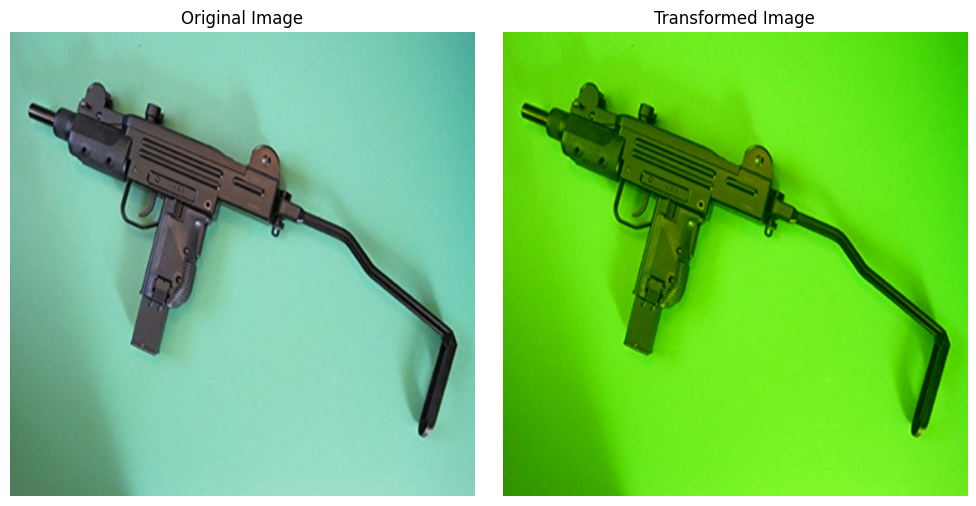

In [ ]:
# Load the image
path_test_image = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/images/train/pistol_0305.jpg"
image_to_transform = load_img(path_test_image)

# Define Albumentations transformations
green_transform = Album.Compose(
    [
        # Remove the Blue then
        # Shift towards green
        # Album.ChannelDropout(channel_drop_range=(2,2), fill_value=1),
        Album.RGBShift(
            always_apply=False,
            p=1.0,
            r_shift_limit=(-174, 0),
            g_shift_limit=(-20, 150),
            b_shift_limit=(-168, -126),
        ),
    ]
)
# Apply the transformation
transformed_image = green_transform(image=np.array(image_to_transform))["image"]
print(transformed_image.shape)

# Load original image
original_image = load_img(path_test_image)

# Create and configure figure
plt.figure(figsize=(10, 5))

# Display original image
plt.subplot(1, 2, 1)
plt.imshow(original_image)
plt.title("Original Image")
plt.axis("off")

# Display transformed image
plt.subplot(1, 2, 2)
plt.imshow(transformed_image)
plt.title("Transformed Image")
plt.axis("off")

plt.tight_layout()
plt.show()

#### Blue Dominant Image (Manual Transformation tested for later use)


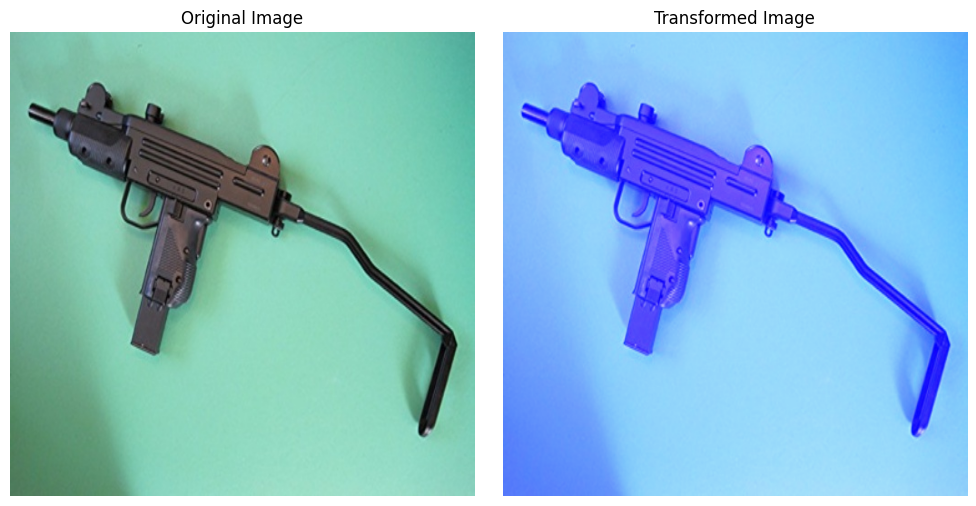

In [ ]:
# Load the image
path_test_image = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/images/train/pistol_0305.jpg"
image_to_transform = load_img(path_test_image)

# Define Albumentations transformations
blue_transform = Album.Compose(
    [
        # Shift towards blue Amplify
        Album.RGBShift(
            always_apply=False,
            p=1.0,
            r_shift_limit=(-10, 10),
            g_shift_limit=(-10, 10),
            b_shift_limit=(-10, 10),
        ),
    ]
)
# Apply the transformation
transformed_image = blue_transform(image=np.array(image_to_transform))["image"]

# Manually shift the blue channel
blue_shift_limit = (-10, 10)
transformed_image[:, :, 2] = np.clip(
    transformed_image[:, :, 2] + np.random.uniform(*blue_shift_limit), 250, 255
).astype(np.uint8)

# Load original image
original_image = load_img(path_test_image)

# Create and configure figure
plt.figure(figsize=(10, 5))

# Display original image
plt.subplot(1, 2, 1)
plt.imshow(original_image)
plt.title("Original Image")
plt.axis("off")

# Display transformed image
plt.subplot(1, 2, 2)
plt.imshow(transformed_image)
plt.title("Transformed Image")
plt.axis("off")

plt.tight_layout()
plt.show()

#### Finally also get X-Ray like Gray Images


(512, 512, 3)


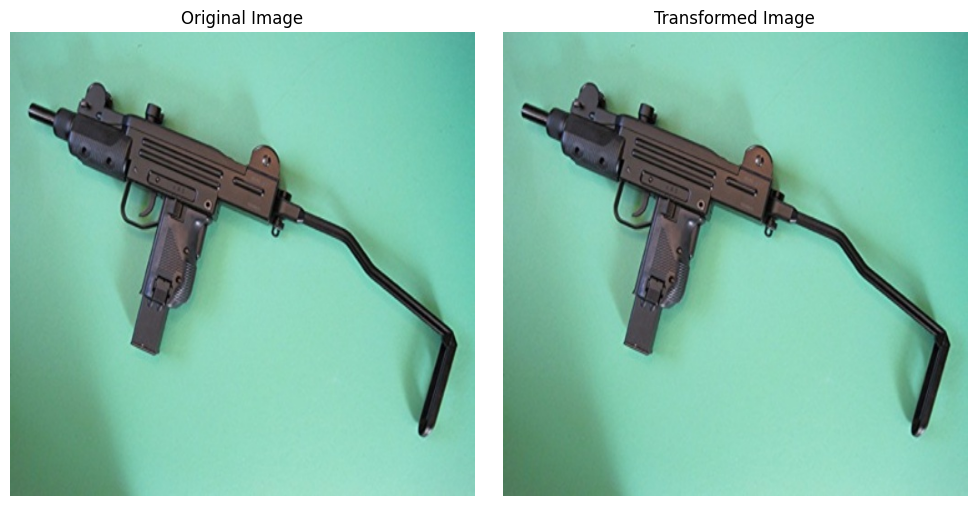

In [ ]:
# Load the image
path_test_image = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/images/train/pistol_0305.jpg"
image_to_transform = load_img(path_test_image)

# Define Albumentations transformations
gray_transform = Album.Compose(
    [
        # X-Ray like appearance
        Album.ToGray(always_apply=False, p=0.5)
    ]
)
# Apply the transformation
transformed_image = gray_transform(image=np.array(image_to_transform))["image"]
print(transformed_image.shape)

# Load original image
original_image = load_img(path_test_image)

# Create and configure figure
plt.figure(figsize=(10, 5))

# Display original image
plt.subplot(1, 2, 1)
plt.imshow(original_image)
plt.title("Original Image")
plt.axis("off")

# Display transformed image
plt.subplot(1, 2, 2)
plt.imshow(transformed_image)
plt.title("Transformed Image")
plt.axis("off")

plt.tight_layout()
plt.show()

### Horizontal Flip and Veritcal Flip


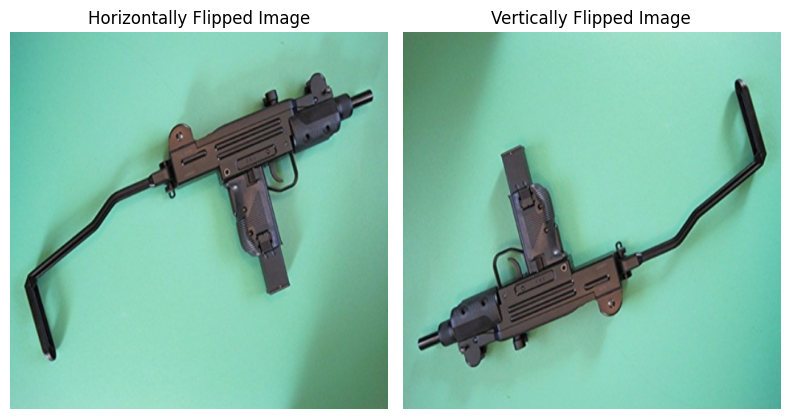

In [ ]:
# Load the image
path_test_image = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/images/train/pistol_0305.jpg"
image_to_transform = load_img(path_test_image)

# Define Albumentations transformations
horizontal_transform = Album.Compose(
    [
        Album.HorizontalFlip(p=1.0),
    ]
)

vertically_transform = Album.Compose(
    [
        Album.VerticalFlip(p=1.0),
    ]
)
# Apply the Horizontal transformation
horizontally_transformed_image = horizontal_transform(
    image=np.array(image_to_transform)
)["image"]

# Apply the Vertical transformation
vertically_transformed_image = vertically_transform(image=np.array(image_to_transform))[
    "image"
]

# Create and configure figure
plt.figure(figsize=(8, 5))

# Display Horizontally flipped image
plt.subplot(1, 2, 1)
plt.imshow(horizontally_transformed_image)
plt.title("Horizontally Flipped Image")
plt.axis("off")

# Display Vertically Flipped Image
plt.subplot(1, 2, 2)
plt.imshow(vertically_transformed_image)
plt.title("Vertically Flipped Image")
plt.axis("off")

plt.tight_layout()
plt.show()

#### Visualization Helper class


In [ ]:
BOX_COLOR = (255, 0, 0)  # Red
TEXT_COLOR = (255, 255, 255)  # White


def visualize_yolo_bbox(img, bbox, class_name, color=BOX_COLOR, thickness=2):
    """Visualizes a single bounding box in YOLO format on the image"""
    x_center, y_center, w, h = bbox
    x_min, y_min, x_max, y_max = (
        int((x_center - w / 2) * img.shape[1]),
        int((y_center - h / 2) * img.shape[0]),
        int((x_center + w / 2) * img.shape[1]),
        int((y_center + h / 2) * img.shape[0]),
    )

    cv2.rectangle(img, (x_min, y_min), (x_max, y_max), color=color, thickness=thickness)

    ((text_width, text_height), _) = cv2.getTextSize(
        class_name, cv2.FONT_HERSHEY_SIMPLEX, 0.75, 1
    )
    cv2.rectangle(
        img,
        (x_min, y_min - int(3 * text_height)),
        (x_min + text_width, y_min),
        BOX_COLOR,
        -1,
    )
    cv2.putText(
        img,
        text=class_name,
        org=(x_min, y_min - int(0.75 * text_height)),
        fontFace=cv2.FONT_HERSHEY_SIMPLEX,
        fontScale=0.75,
        color=TEXT_COLOR,
        lineType=cv2.LINE_AA,
    )
    return img


def visualize_yolo(image, bboxes, category_ids, category_id_to_names):
    img = image.copy()
    for bbox, category_id in zip(bboxes, category_ids):
        class_name = category_id_to_names[category_id]
        img = visualize_yolo_bbox(img, bbox, class_name)
    plt.imshow(img)

#### Sharpen and Random Brightness & Contrast


[[0.30357142857142855, 0.3984126984126984, 0.55, 0.638095238095238]] [0.0]
(512, 512, 3)


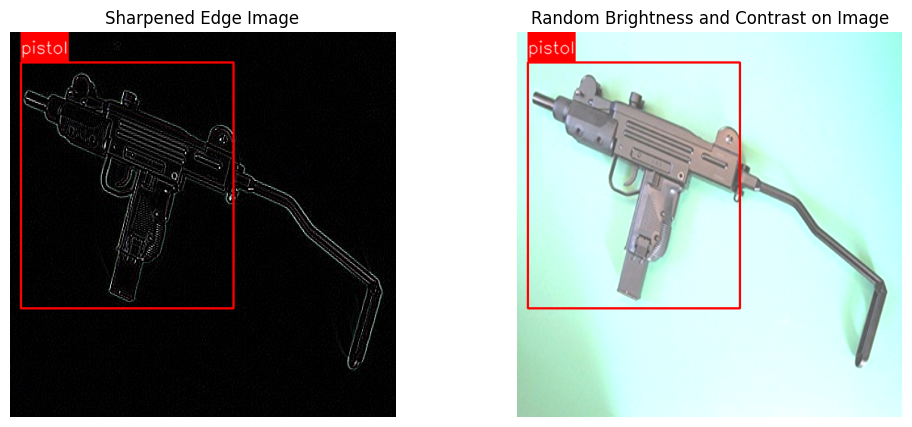

In [ ]:
# Load the image
path_test_image = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/images/train/pistol_0305.jpg"
path_test_bbox = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/labels/train/pistol_0305.txt"


with open(path_test_bbox, "r") as f:
    contents = f.read()
    contents = np.fromstring(contents, sep=" ").tolist()
image_to_transform = load_img(path_test_image)
# Define Albumentations transformations
sharpen_transform = Album.Compose(
    [
        Album.Sharpen(
            always_apply=False, p=1.0, alpha=(1.0, 1.0), lightness=(0.0, 0.0)
        ),
    ],
    bbox_params=Album.BboxParams(
        format="yolo", min_area=0, min_visibility=0.1, label_fields=["class_labels"]
    ),
)

random_brightness_contrast_transform = Album.Compose(
    [
        Album.RandomBrightnessContrast(
            always_apply=False,
            p=1.0,
            brightness_limit=(-0.2, 0.51),
            contrast_limit=(-0.23, 0.32),
            brightness_by_max=True,
        )
    ],
    bbox_params=Album.BboxParams(
        format="yolo", min_area=0, min_visibility=0.1, label_fields=["class_labels"]
    ),
)

# Get the Class Labels and the proper Bounding Boxes for the Image
class_labels = contents[:1]
class_bboxes = [contents[1:]]
print(class_bboxes, class_labels)
# Apply the Sharpen transformation
sharpness_transformed_image = sharpen_transform(
    image=np.array(image_to_transform), bboxes=class_bboxes, class_labels=class_labels
)

sharpness_image = sharpness_transformed_image["image"]
sharpness_bboxes_yolo = sharpness_transformed_image["bboxes"]
sharpness_category_ids = sharpness_transformed_image["class_labels"]
category_id_to_names = category_id_to_names

print(sharpness_image.shape)

# Apply the random_brightness_contrast_transform transformation
random_brightness_contrast_transformed_image = random_brightness_contrast_transform(
    image=np.array(image_to_transform), bboxes=class_bboxes, class_labels=class_labels
)

random_bc_image = random_brightness_contrast_transformed_image["image"]
random_bc_bboxes_yolo = random_brightness_contrast_transformed_image["bboxes"]
random_bc_category_ids = random_brightness_contrast_transformed_image["class_labels"]
category_id_to_names = category_id_to_names

# Create and configure figure
plt.figure(figsize=(12, 5))

# Display Sharpen image
plt.subplot(1, 2, 1)
visualize_yolo(
    sharpness_image, sharpness_bboxes_yolo, sharpness_category_ids, category_id_to_names
)
plt.title("Sharpened Edge Image")
plt.axis("off")

# Display Random Bright and contrast Image
plt.subplot(1, 2, 2)
visualize_yolo(
    random_bc_image, random_bc_bboxes_yolo, random_bc_category_ids, category_id_to_names
)
plt.title("Random Brightness and Contrast on Image")
plt.axis("off")
plt.show()

#### Modified Run method with Augmentation


In [ ]:
def one_of_transformation(
    transformation_type, sample_image, class_bboxes, class_labels, raw_image
):
    """
    This function takes a Args as input and returns based on the switch statement with return statements and defaults.

    Args:
      transformation_type(str): Selected Transformation we would like to apply
      sample_image:(np.ndarray) The Sample Image to be Transformed.
      class_bboxes:(list<float>) The Bounding Box for that image.
      class_labels:(float) The Class label in the float format.

    Returns:
      Based on the selected case it returns the necessary transformation or defaults to Inferno transformation.
    """
    # print('Switch',transformation_type, random_brightness_contrast_transform)

    match transformation_type:
        case "inferno":
            # Uses the raw Image for Manual Shift
            # Define Albumentations transformation
            inferno_inline_transform = Album.Compose(
                [
                    Album.RGBShift(
                        always_apply=False,
                        p=1.0,
                        r_shift_limit=(-10, 10),
                        g_shift_limit=(-10, 10),
                        b_shift_limit=(-10, 10),
                    ),
                ]
            )

            # Apply Albumentations transformation
            inferno_transformed_image = inferno_inline_transform(
                image=np.array(raw_image)
            )["image"]

            # Manually shift the red channel
            red_shift_limit = (-10, 10)
            inferno_transformed_image[:, :, 0] = np.clip(
                inferno_transformed_image[:, :, 0]
                + np.random.uniform(*red_shift_limit),
                200,
                255,
            ).astype(np.uint8)

            return inferno_transformed_image

        case "green":
            # Uses the raw Image for Manual Shift
            # Define Albumentations transformation
            green_inline_transform = Album.Compose(
                [
                    Album.RGBShift(
                        always_apply=False,
                        p=1.0,
                        r_shift_limit=(-10, 10),
                        g_shift_limit=(-10, 10),
                        b_shift_limit=(-10, 10),
                    ),
                ]
            )

            # Apply Albumentations transformation
            green_transformed_image = green_inline_transform(image=np.array(raw_image))[
                "image"
            ]

            # Manually shift the green channel
            green_shift_limit = (-10, 10)
            green_transformed_image[:, :, 1] = np.clip(
                green_transformed_image[:, :, 1]
                + np.random.uniform(*green_shift_limit),
                200,
                255,
            ).astype(np.uint8)

            return green_transformed_image

        case "blue":
            # Uses the raw Image for Manual Shift
            # Define a balance Albumentations transformations
            blue_inline_transform = Album.Compose(
                [
                    # Shift towards blue Amplify
                    Album.RGBShift(
                        always_apply=False,
                        p=1.0,
                        r_shift_limit=(-20, 20),
                        g_shift_limit=(-20, 20),
                        b_shift_limit=(-20, 20),
                    ),
                ]
            )
            # Apply the transformation
            blue_transformed_image = blue_inline_transform(image=np.array(raw_image))[
                "image"
            ]

            # Manually shift the blue channel
            blue_shift_limit = (-20, 20)
            blue_transformed_image[:, :, 2] = np.clip(
                blue_transformed_image[:, :, 2] + np.random.uniform(*blue_shift_limit),
                20,
                255,
            ).astype(np.uint8)
            return blue_transformed_image

        case "gray":
            gray_transformed_image = gray_transform(image=sample_image)
            print("gray_transformed_image", type(gray_transformed_image))
            return gray_transformed_image

        case "horizontal":
            horizontally_transformed_image = horizontal_transform(image=sample_image)
            return horizontally_transformed_image

        case "vertical":
            vertically_transformed_image = vertically_transform(image=sample_image)
            return vertically_transformed_image

        case "sharp":
            sharpness_transformed_image = sharpen_transform(
                image=sample_image, bboxes=class_bboxes, class_labels=class_labels
            )
            print("sharpness_transformed_image", type(sharpness_transformed_image))

            return sharpness_transformed_image

        case "random_bc":
            random_brightness_contrast_transformed_image = (
                random_brightness_contrast_transform(
                    image=sample_image, bboxes=class_bboxes, class_labels=class_labels
                )
            )
            print(
                "random_brightness_contrast_transformed_image",
                type(random_brightness_contrast_transformed_image),
            )

            return random_brightness_contrast_transformed_image

        case _:
            inferno_transformed_image = inferno_transform(image=sample_image)
            return inferno_transformed_image

In [ ]:
def run_augmentation():
    # URL for train images and labels
    url_train_images = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/images/train/"
    url_train_labels = "/content/drive/MyDrive/weapon-detection-deep-learning/weapon_train_test_dataset/data/weapon_detection/train_test_data/labels/train/"

    # Create an instance of the WeaponDataset
    train_dataset = WeaponDataset(url_train_images, url_train_labels, class_names)

    # The selection for the Transformation Types
    transformation_types = [
        "inferno",
        "green",
        "blue",
        "horizontal",
        "vertical",
        "sharp",
        "random_bc",
    ]

    weights = [
        2,
        1,
        1,
        1,
        1,
        3,
        1,
    ]  # assigns 20% weight to 'inferno' and 30% weight to sharpness

    # Choose a 3 sample index to visualize
    for x in range(len(train_dataset)):
        sample_index = x
        # Get the sample
        sample_image, sample_target, sample_image_name = train_dataset[sample_index]

        # Initialize
        class_bboxes = sample_target["boxes"]
        class_labels = sample_target["labels"]
        raw_image = None

        # Transformation Type selection random_bc sharp
        transformation_selection = random.choices(transformation_types, weights)[0]

        if (
            transformation_selection == "inferno"
            or transformation_selection == "green"
            or transformation_selection == "blue"
        ):
            sample_image_url = url_train_images + sample_image_name
            raw_image = load_img(sample_image_url)

        transformed_image = one_of_transformation(
            transformation_type=transformation_selection,
            sample_image=sample_image,
            class_bboxes=class_bboxes,
            class_labels=class_labels,
            raw_image=raw_image,
        )
        if isinstance(transformed_image, dict):
            transformed_image_data = transformed_image["image"]
            scaled_image = transformed_image_data
            image_scaled = (scaled_image * 255).astype(np.uint8)
            image_scaled = np.clip(image_scaled, 0, 255)
            cv2.imwrite(
                f"{url_train_images}/{sample_image_name}_{transformation_selection}.jpg",
                image_scaled,
            )
        else:
            transformed_image_data = transformed_image
            cv2.imwrite(
                f"{url_train_images}/{sample_image_name}_{transformation_selection}.jpg",
                transformed_image_data,
            )

        # Concatenate and store the labels
        concatenated_string = ""
        for box in class_bboxes.tolist()[0]:
            concatenated_string = f"{concatenated_string} {box}"

        concatenated_string = f"{class_labels.item()} {concatenated_string}"

        with open(
            f"{url_train_labels}/{sample_image_name}_{transformation_selection}.txt",
            "w",
        ) as file:
            file.write(concatenated_string)

#### Augmentation for the Dataset


Transform random_bc
random_brightness_contrast_transformed_image <class 'dict'>


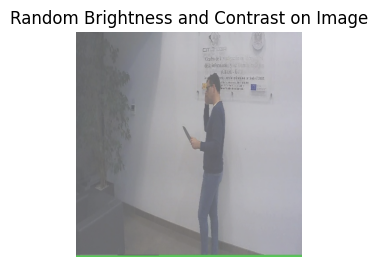

Transform sharp
sharpness_transformed_image <class 'dict'>


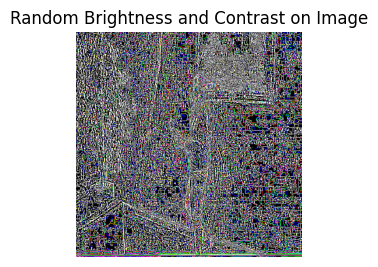

Transform inferno


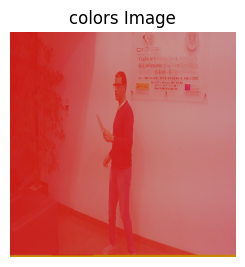

Transform sharp
sharpness_transformed_image <class 'dict'>


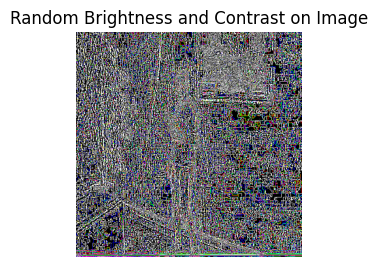

Transform vertical


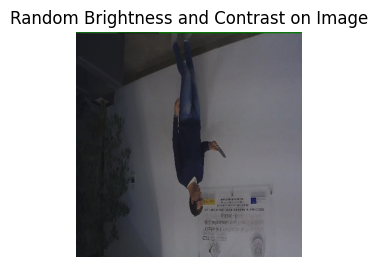

Transform sharp
sharpness_transformed_image <class 'dict'>


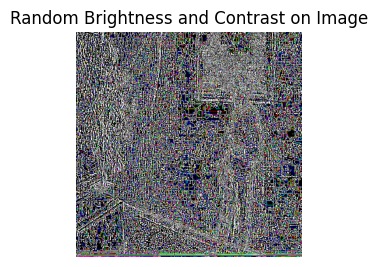

Transform horizontal


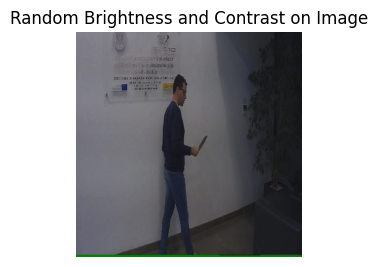

Transform random_bc
random_brightness_contrast_transformed_image <class 'dict'>


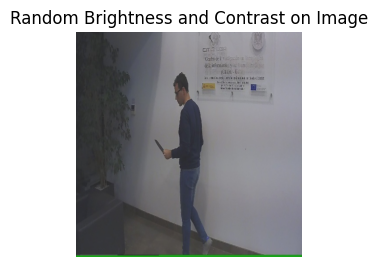

Transform sharp
sharpness_transformed_image <class 'dict'>


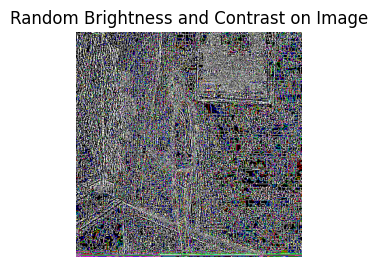

Transform vertical


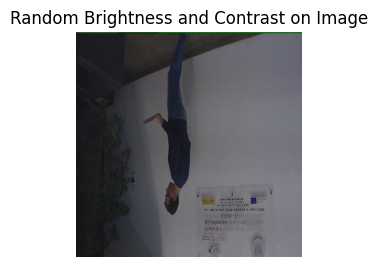

Transform green


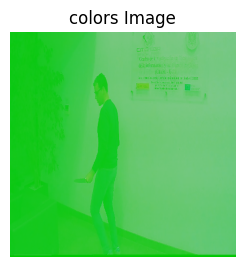

Transform vertical


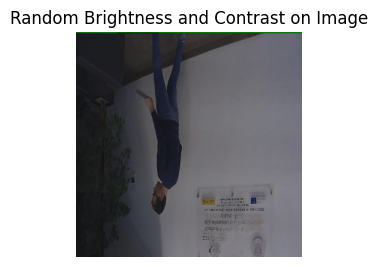

Transform sharp
sharpness_transformed_image <class 'dict'>


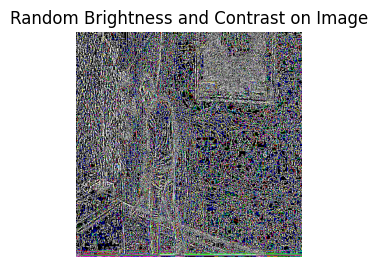

Transform sharp
sharpness_transformed_image <class 'dict'>


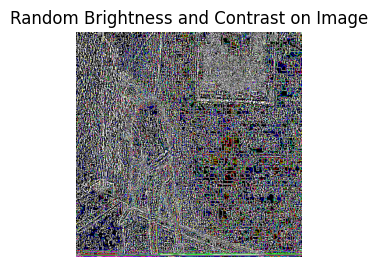

Transform blue


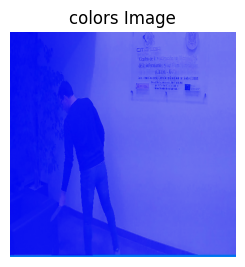

Transform inferno


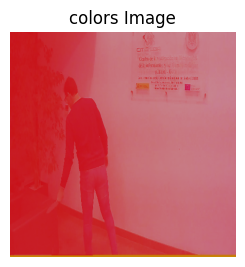

Transform sharp
sharpness_transformed_image <class 'dict'>


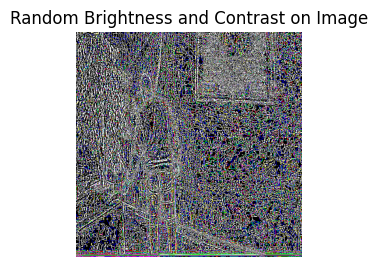

Transform random_bc
random_brightness_contrast_transformed_image <class 'dict'>


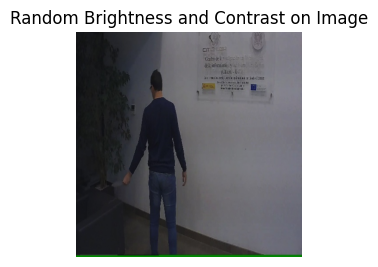

Transform vertical


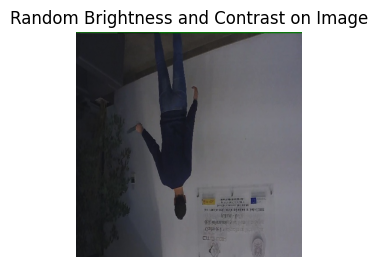

Transform random_bc
random_brightness_contrast_transformed_image <class 'dict'>


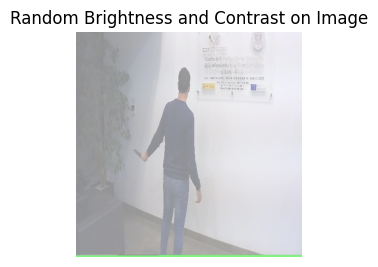

Transform sharp
sharpness_transformed_image <class 'dict'>


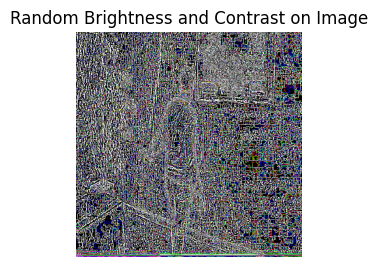

Transform inferno


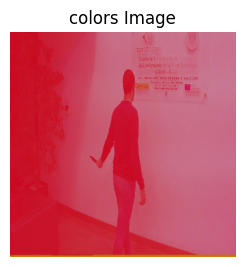

Transform vertical


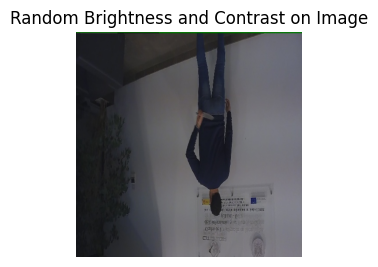

Transform blue


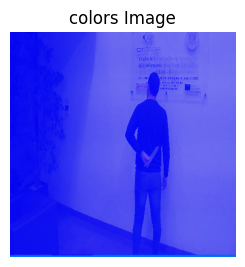

Transform blue


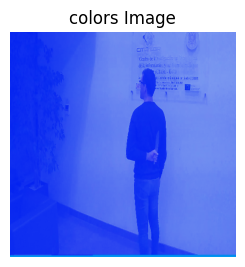

Transform random_bc
random_brightness_contrast_transformed_image <class 'dict'>


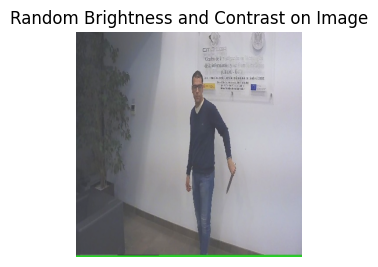

Transform sharp
sharpness_transformed_image <class 'dict'>


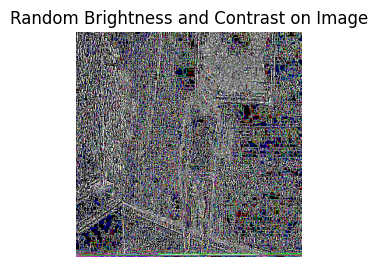

Transform sharp
sharpness_transformed_image <class 'dict'>


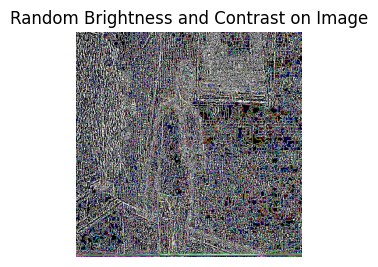

Transform vertical


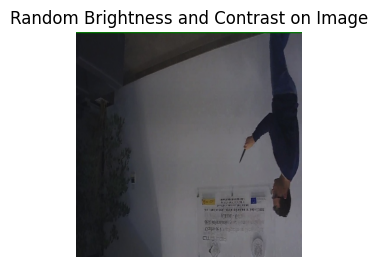

Transform vertical


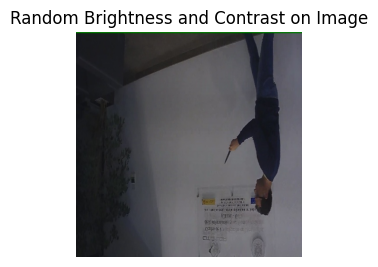

Transform inferno


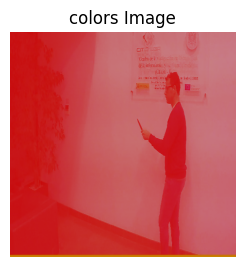

Transform inferno


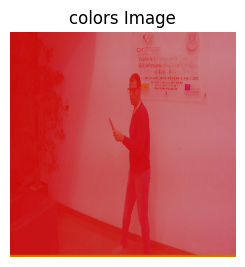

Transform sharp
sharpness_transformed_image <class 'dict'>


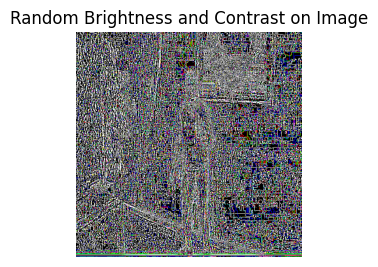

Transform sharp
sharpness_transformed_image <class 'dict'>


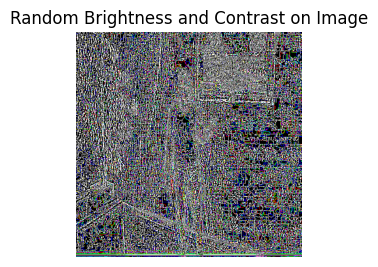

Transform sharp
sharpness_transformed_image <class 'dict'>


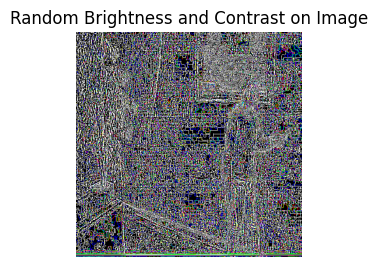

Transform blue


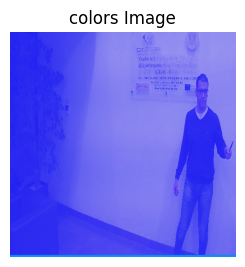

Transform green


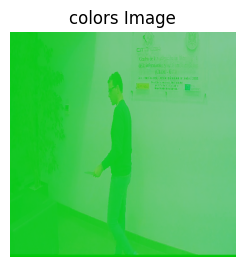

Transform blue


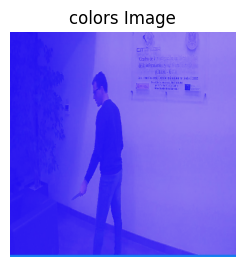

Transform vertical


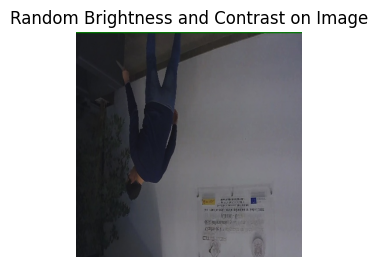

Transform vertical


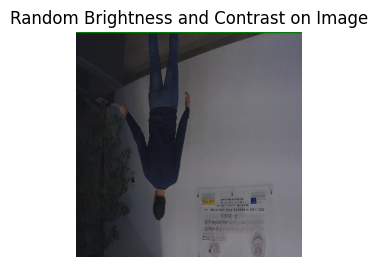

Transform inferno


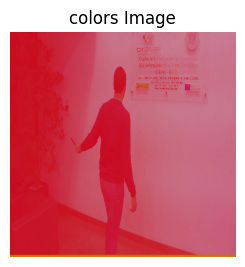

Transform blue


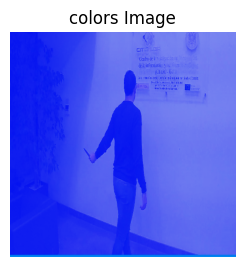

Transform horizontal


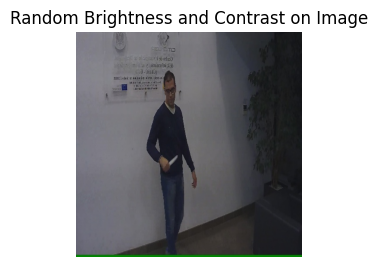

Transform blue


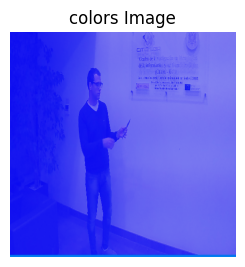

Transform sharp
sharpness_transformed_image <class 'dict'>


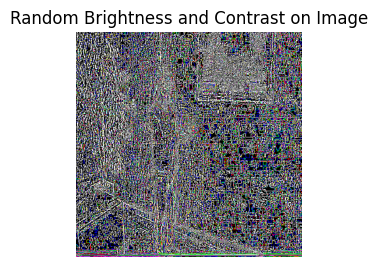

Transform sharp
sharpness_transformed_image <class 'dict'>


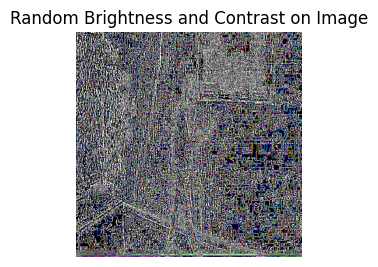

Transform inferno


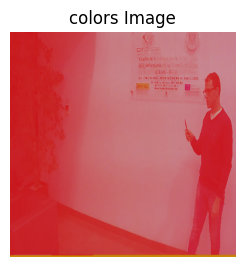

Transform sharp
sharpness_transformed_image <class 'dict'>


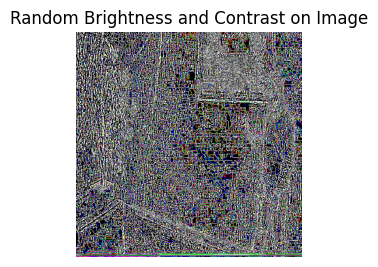

Transform sharp
sharpness_transformed_image <class 'dict'>


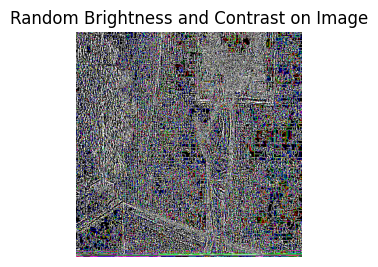

Transform inferno


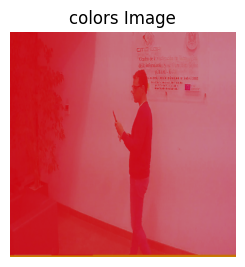

Transform inferno


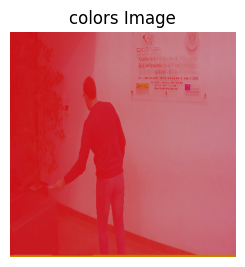

Transform horizontal


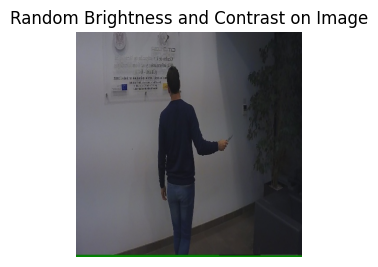

Transform horizontal


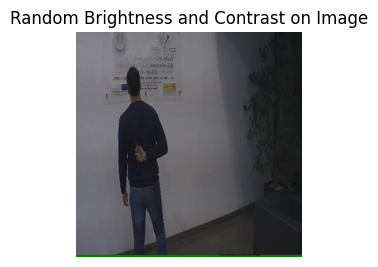

Transform sharp
sharpness_transformed_image <class 'dict'>


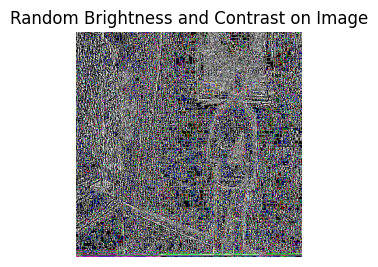

Transform inferno


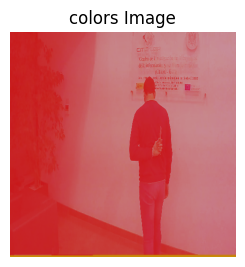

Transform blue


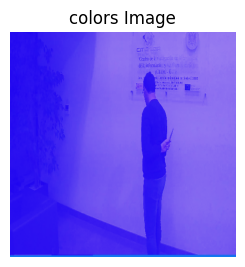

Transform inferno


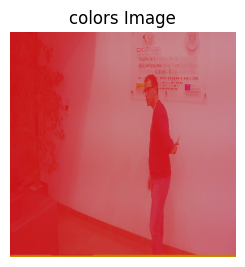

Transform inferno


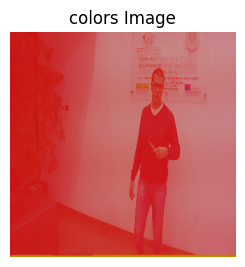

Transform random_bc
random_brightness_contrast_transformed_image <class 'dict'>


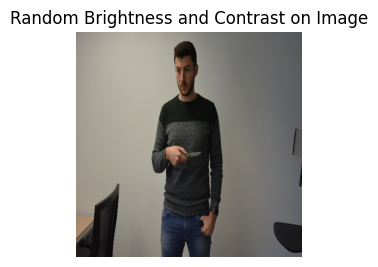

Transform sharp
sharpness_transformed_image <class 'dict'>


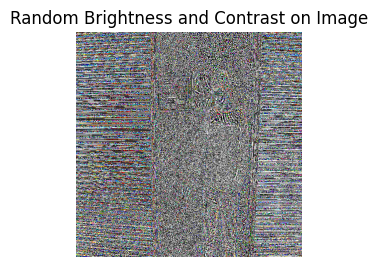

Transform sharp
sharpness_transformed_image <class 'dict'>


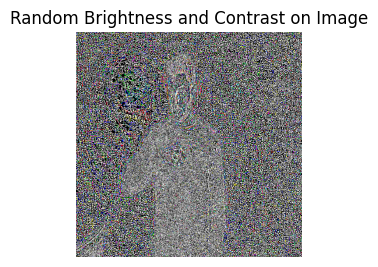

Transform inferno


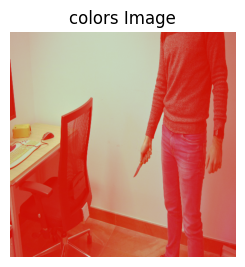

Transform sharp
sharpness_transformed_image <class 'dict'>


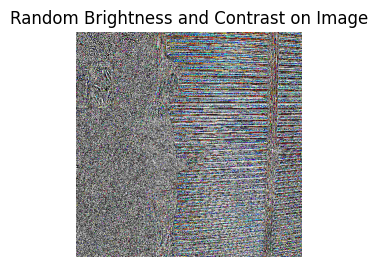

Transform green


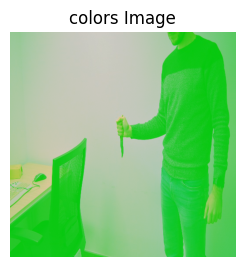

Transform sharp
sharpness_transformed_image <class 'dict'>


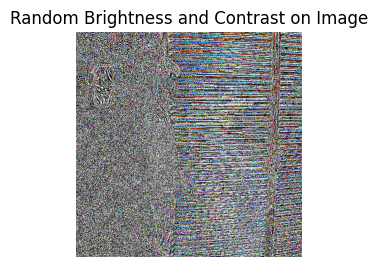

Transform green


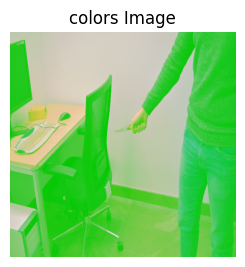

Transform horizontal


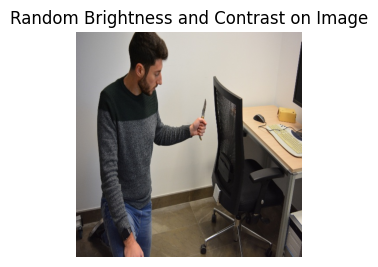

Transform sharp
sharpness_transformed_image <class 'dict'>


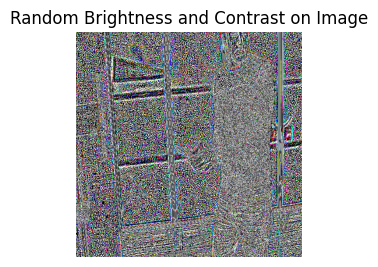

Transform sharp
sharpness_transformed_image <class 'dict'>


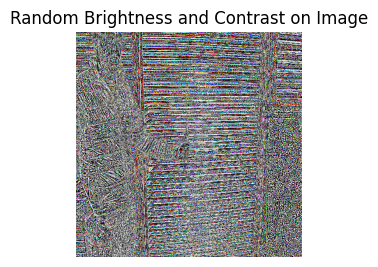

Transform horizontal


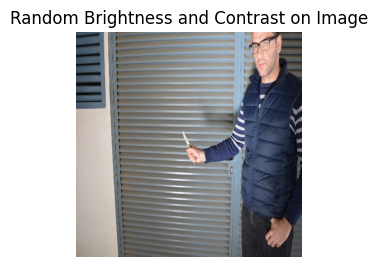

Transform sharp
sharpness_transformed_image <class 'dict'>


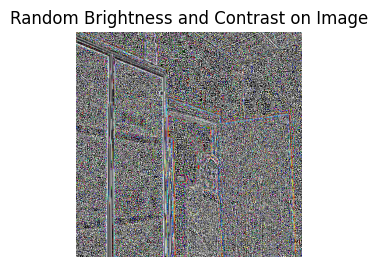

Transform sharp
sharpness_transformed_image <class 'dict'>


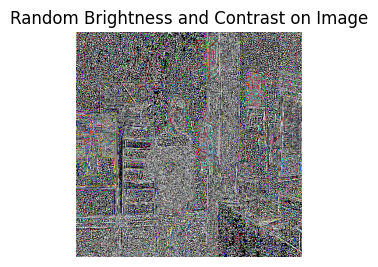

Transform random_bc
random_brightness_contrast_transformed_image <class 'dict'>


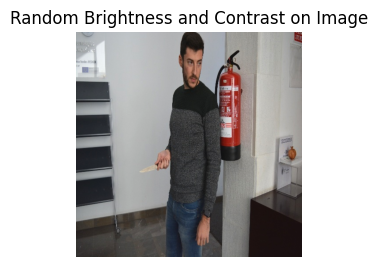

Transform sharp
sharpness_transformed_image <class 'dict'>


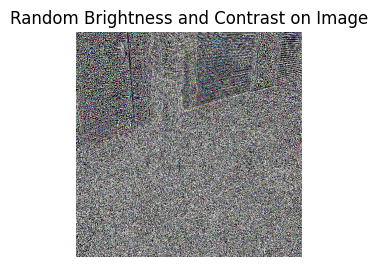

Transform horizontal


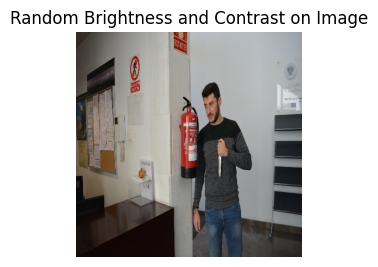

Transform horizontal


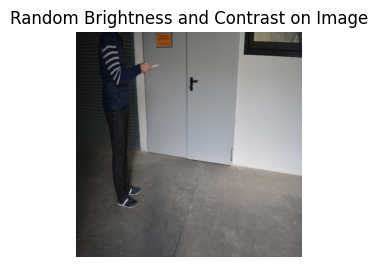

Transform sharp
sharpness_transformed_image <class 'dict'>


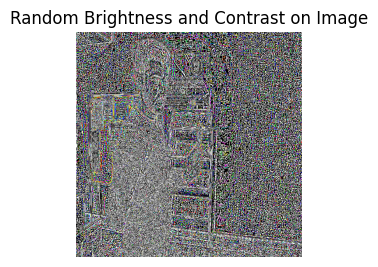

Transform blue


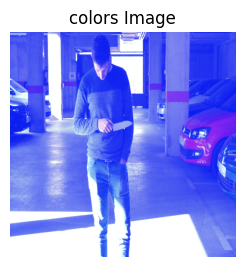

Transform sharp
sharpness_transformed_image <class 'dict'>


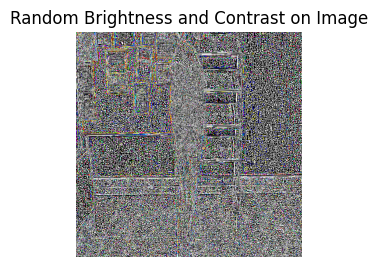

Transform blue


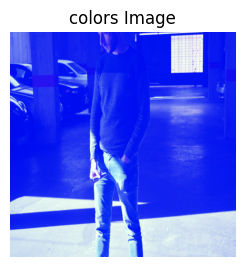

Transform blue


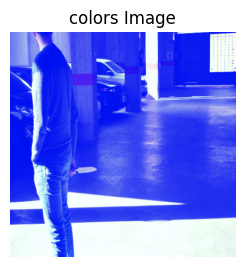

Transform blue


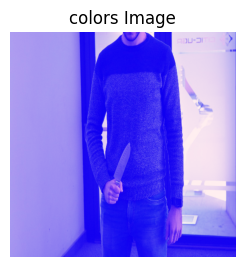

Transform horizontal


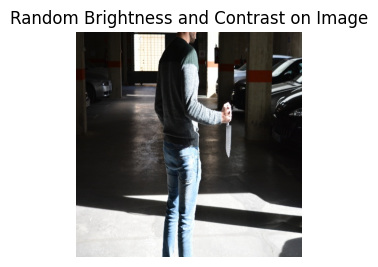

Transform inferno


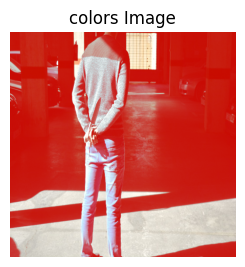

Transform blue


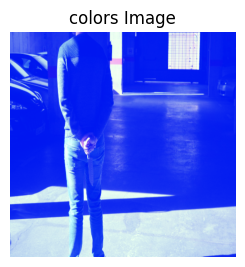

Transform random_bc
random_brightness_contrast_transformed_image <class 'dict'>


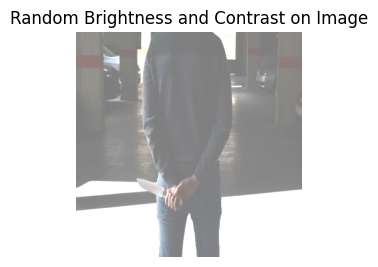

Transform inferno


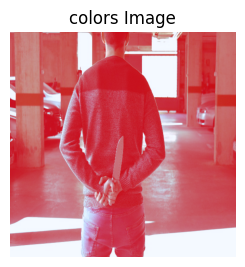

Transform sharp
sharpness_transformed_image <class 'dict'>


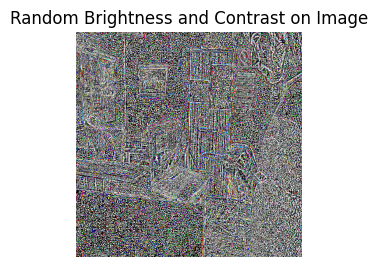

Transform sharp
sharpness_transformed_image <class 'dict'>


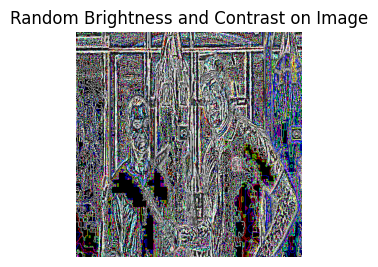

Transform sharp
sharpness_transformed_image <class 'dict'>


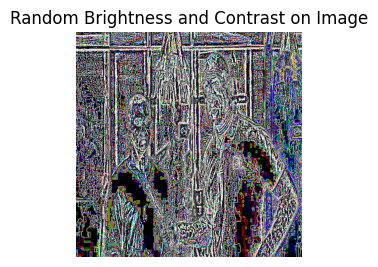

Transform blue


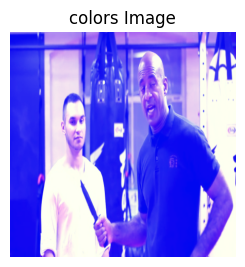

Transform sharp
sharpness_transformed_image <class 'dict'>


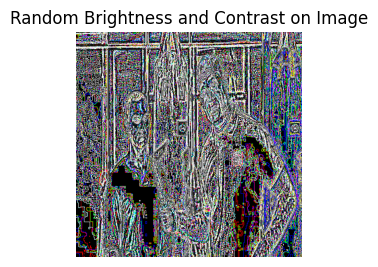

Transform inferno


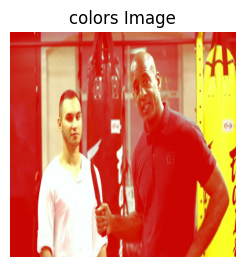

Transform random_bc
random_brightness_contrast_transformed_image <class 'dict'>


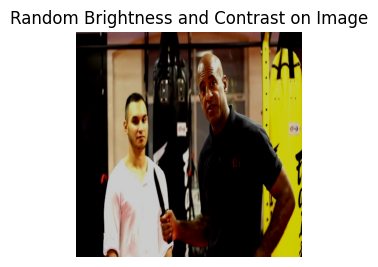

Transform vertical


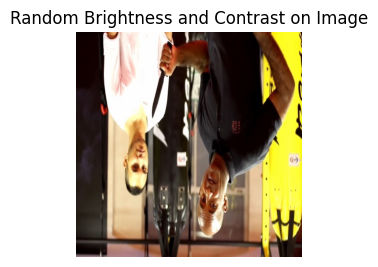

Transform green


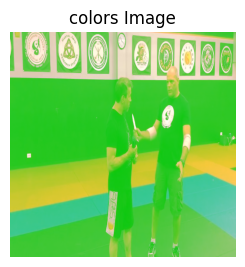

Transform inferno


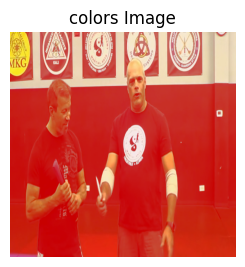

Transform sharp
sharpness_transformed_image <class 'dict'>


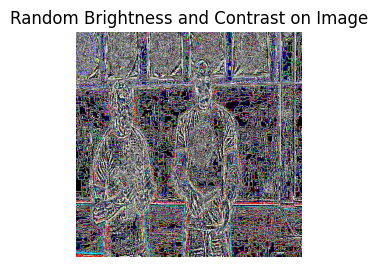

Transform sharp
sharpness_transformed_image <class 'dict'>


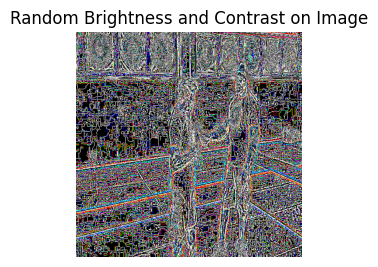

Transform green


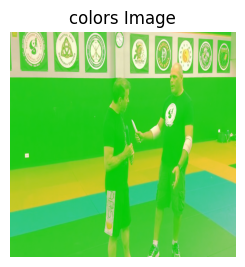

Transform inferno


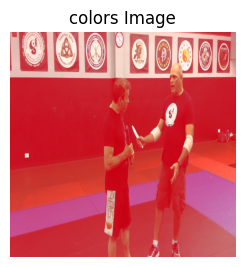

In [ ]:
run_augmentation()

### Model Improvements and Fine-Tuning


In [78]:
LR = 1e-4
WD = 1e-4
DO = 0.4
EPOCHS = 2
NQ = 100

In [162]:
class DETRModelTuned(nn.Module):
    def __init__(self, num_classes, num_queries):
        super(DETRModelTuned, self).__init__()
        self.num_classes = num_classes
        self.num_queries = num_queries

        self.model = torch.hub.load(
            "facebookresearch/detr", "detr_resnet50", pretrained=True
        )
        self.in_features = self.model.class_embed.in_features

        # Replaced the class_embed with a Linear layer to a Sequential with dropout
        self.model.class_embed = nn.Sequential(
            nn.Linear(in_features=self.in_features, out_features=self.num_classes),
            nn.Dropout(p=DO),
        )

        self.model.num_queries = self.num_queries
        self.model.requires_grad_()

    def forward(self, images):
        # Extract the weights before the forward pass
        weights = self.model.state_dict()

        # Perform the forward pass
        output = self.model(images)

        return output, weights

In [79]:
model = DETRModelTuned(num_classes=num_classes, num_queries=num_queries)
model

Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


DETRModelTuned(
  (model): DETR(
    (transformer): Transformer(
      (encoder): TransformerEncoder(
        (layers): ModuleList(
          (0-5): 6 x TransformerEncoderLayer(
            (self_attn): MultiheadAttention(
              (out_proj): NonDynamicallyQuantizableLinear(in_features=256, out_features=256, bias=True)
            )
            (linear1): Linear(in_features=256, out_features=2048, bias=True)
            (dropout): Dropout(p=0.1, inplace=False)
            (linear2): Linear(in_features=2048, out_features=256, bias=True)
            (norm1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
            (norm2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
            (dropout1): Dropout(p=0.1, inplace=False)
            (dropout2): Dropout(p=0.1, inplace=False)
          )
        )
      )
      (decoder): TransformerDecoder(
        (layers): ModuleList(
          (0-5): 6 x TransformerDecoderLayer(
            (self_attn): MultiheadAttention(
      

In [ ]:
model_original = DETRModel(num_classes=num_classes, num_queries=num_queries)
model_original

Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


DETRModel(
  (model): DETR(
    (transformer): Transformer(
      (encoder): TransformerEncoder(
        (layers): ModuleList(
          (0-5): 6 x TransformerEncoderLayer(
            (self_attn): MultiheadAttention(
              (out_proj): NonDynamicallyQuantizableLinear(in_features=256, out_features=256, bias=True)
            )
            (linear1): Linear(in_features=256, out_features=2048, bias=True)
            (dropout): Dropout(p=0.1, inplace=False)
            (linear2): Linear(in_features=2048, out_features=256, bias=True)
            (norm1): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
            (norm2): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
            (dropout1): Dropout(p=0.1, inplace=False)
            (dropout2): Dropout(p=0.1, inplace=False)
          )
        )
      )
      (decoder): TransformerDecoder(
        (layers): ModuleList(
          (0-5): 6 x TransformerDecoderLayer(
            (self_attn): MultiheadAttention(
           

### Run on the Augmented Dataset


In [ ]:
def run_on_augmented_set():
    # Use your dataset without folds
    weapon_dataset = WeaponDataset(
        image_url=url_train_images, label_url=url_train_labels, class_names=class_names
    )

    # Split the dataset into training and validation sets (adjust the ratio if needed)
    total_samples = len(weapon_dataset)
    print("Running on Total Augmented data --->", total_samples)

    train_size = int(0.8 * total_samples)
    val_size = total_samples - train_size

    train_dataset, val_dataset = torch.utils.data.random_split(
        weapon_dataset,
        [train_size, val_size],
        generator=torch.Generator().manual_seed(seed),  # Set a seed for reproducibility
    )

    train_data_loader = DataLoader(
        train_dataset,
        batch_size=BATCH_SIZE,
        shuffle=True,
        num_workers=4,
        collate_fn=collate_fn,
    )

    valid_data_loader = DataLoader(
        val_dataset,
        batch_size=BATCH_SIZE,
        shuffle=False,
        num_workers=4,
        collate_fn=collate_fn,
    )

    device = torch.device("cuda:0")  # torch.device("cpu")
    model = DETRModel(num_classes=num_classes, num_queries=NQ)
    model = model.to(device)
    criterion = SetCriterion(
        num_classes - 1, matcher, weight_dict, eos_coef=null_class_coef, losses=losses
    )
    criterion = criterion.to(device)

    optimizer = torch.optim.AdamW(model.parameters(), lr=LR)

    best_loss = 10**5

    # Save a Model on this Path
    saved_model_path = "/content/drive/MyDrive/saved-models"

    for epoch in range(EPOCHS):
        train_loss = train_fn(
            train_data_loader,
            model,
            criterion,
            optimizer,
            device,
            scheduler=None,
            epoch=epoch,
        )
        valid_loss = eval_fn(valid_data_loader, model, criterion, device)

        print(
            "|EPOCH {}| TRAIN_LOSS {}| VALID_LOSS {}|".format(
                epoch + 1, train_loss.avg, valid_loss.avg
            )
        )

        if valid_loss.avg < best_loss:
            best_loss = valid_loss.avg
            print("Best model found in Epoch {}........Saving Model".format(epoch + 1))
            torch.save(
                model.state_dict(),
                f"{saved_model_path}/detr_best_with_transformations_fine_tuned_experiment_5.pth",
            )

#### Experiment One


Fine Tuning Parameters

- Learning Rate: 0.0001 (1e-4)

- Weight Decay: 0.0001 (1e-4)

- Dropout: 0.4 (40%)

- Epoch(s): 1 Epoch Only

- Number of Queries: 100


In [ ]:
run_on_augmented_set()

Running on Total Augmented data ---> 10275


Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


  0%|          | 0/1028 [00:00<?, ?it/s]

<ipython-input-14-230e667be549>:19: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  targets = [{k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets]


Training Losses ===> tensor(2.75996590, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.77673113, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.88632882, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.33248496, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.56128383, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.28590727, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.57176852, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.42583489, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.41414046, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.23503137, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.47501826, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.56980038, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(

  0%|          | 0/257 [00:00<?, ?it/s]

<ipython-input-15-e58adb034215>:17: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  targets = [{k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets]


Validation Losses ===> tensor(0.91246265, device='cuda:0')
Validation Losses ===> tensor(1.12979281, device='cuda:0')
Validation Losses ===> tensor(0.88056511, device='cuda:0')
Validation Losses ===> tensor(0.92584074, device='cuda:0')
Validation Losses ===> tensor(0.73970813, device='cuda:0')
Validation Losses ===> tensor(0.84617984, device='cuda:0')
Validation Losses ===> tensor(0.81293857, device='cuda:0')
Validation Losses ===> tensor(0.88226414, device='cuda:0')
Validation Losses ===> tensor(0.97397256, device='cuda:0')
Validation Losses ===> tensor(0.93683505, device='cuda:0')
Validation Losses ===> tensor(1.06634438, device='cuda:0')
Validation Losses ===> tensor(0.95992035, device='cuda:0')
Validation Losses ===> tensor(0.65378380, device='cuda:0')
Validation Losses ===> tensor(0.94181067, device='cuda:0')
Validation Losses ===> tensor(0.90624583, device='cuda:0')
Validation Losses ===> tensor(0.94188261, device='cuda:0')
Validation Losses ===> tensor(0.84410483, device='cuda:0

#### Experiment Two


**Fine Tuning Parameters**:

- Learning Rate: 0.0000001 (1e-7)

- Weight Decay: 0.0001 (1e-4)

- Dropout: 0.2 (20%)

- Epoch(s): 3 Epochs

- Number of Queries: 125


In [ ]:
run_on_augmented_set()

Running on Total Augmented data ---> 10275


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equi

  0%|          | 0/1028 [00:00<?, ?it/s]

<ipython-input-13-cf961c7d8fdc>:19: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  targets = [{k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets]


Training Losses ===> tensor(1.7348, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.6197, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.8280, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5279, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.8136, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5937, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.8265, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(2.0009, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.8088, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(2.0183, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.8757, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.7295, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.8824, device='cuda:0', grad_fn=<AddBackward0>)

  0%|          | 0/257 [00:00<?, ?it/s]

<ipython-input-14-e58adb034215>:17: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  targets = [{k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets]


Validation Losses ===> tensor(1.4159, device='cuda:0')
Validation Losses ===> tensor(1.5990, device='cuda:0')
Validation Losses ===> tensor(1.6038, device='cuda:0')
Validation Losses ===> tensor(1.6870, device='cuda:0')
Validation Losses ===> tensor(1.6656, device='cuda:0')
Validation Losses ===> tensor(1.6719, device='cuda:0')
Validation Losses ===> tensor(1.3423, device='cuda:0')
Validation Losses ===> tensor(1.5351, device='cuda:0')
Validation Losses ===> tensor(1.3392, device='cuda:0')
Validation Losses ===> tensor(1.5168, device='cuda:0')
Validation Losses ===> tensor(2.0417, device='cuda:0')
Validation Losses ===> tensor(1.3693, device='cuda:0')
Validation Losses ===> tensor(1.3498, device='cuda:0')
Validation Losses ===> tensor(1.6584, device='cuda:0')
Validation Losses ===> tensor(1.1936, device='cuda:0')
Validation Losses ===> tensor(1.4029, device='cuda:0')
Validation Losses ===> tensor(1.8025, device='cuda:0')
Validation Losses ===> tensor(1.7099, device='cuda:0')
Validation

  0%|          | 0/1028 [00:00<?, ?it/s]

Training Losses ===> tensor(1.5892, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.9866, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.3520, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.7182, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.7316, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.7258, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.9203, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.8160, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.9873, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.7236, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.4542, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5125, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5598, device='cuda:0', grad_fn=<AddBackward0>)

  0%|          | 0/257 [00:00<?, ?it/s]

Validation Losses ===> tensor(1.3011, device='cuda:0')
Validation Losses ===> tensor(1.6284, device='cuda:0')
Validation Losses ===> tensor(1.4283, device='cuda:0')
Validation Losses ===> tensor(1.5980, device='cuda:0')
Validation Losses ===> tensor(1.5333, device='cuda:0')
Validation Losses ===> tensor(1.5221, device='cuda:0')
Validation Losses ===> tensor(1.2460, device='cuda:0')
Validation Losses ===> tensor(1.4204, device='cuda:0')
Validation Losses ===> tensor(1.2185, device='cuda:0')
Validation Losses ===> tensor(1.3796, device='cuda:0')
Validation Losses ===> tensor(1.9381, device='cuda:0')
Validation Losses ===> tensor(1.2681, device='cuda:0')
Validation Losses ===> tensor(1.2026, device='cuda:0')
Validation Losses ===> tensor(1.5541, device='cuda:0')
Validation Losses ===> tensor(1.0865, device='cuda:0')
Validation Losses ===> tensor(1.3050, device='cuda:0')
Validation Losses ===> tensor(1.6810, device='cuda:0')
Validation Losses ===> tensor(1.4638, device='cuda:0')
Validation

  0%|          | 0/1028 [00:00<?, ?it/s]

Training Losses ===> tensor(1.4530, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.2752, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.4929, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.3731, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.2678, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.4296, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.6667, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.3407, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.3529, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.4790, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.3602, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5821, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.7868, device='cuda:0', grad_fn=<AddBackward0>)

  0%|          | 0/257 [00:00<?, ?it/s]

Validation Losses ===> tensor(1.1785, device='cuda:0')
Validation Losses ===> tensor(1.3942, device='cuda:0')
Validation Losses ===> tensor(1.3335, device='cuda:0')
Validation Losses ===> tensor(1.5376, device='cuda:0')
Validation Losses ===> tensor(1.4050, device='cuda:0')
Validation Losses ===> tensor(1.4081, device='cuda:0')
Validation Losses ===> tensor(1.2234, device='cuda:0')
Validation Losses ===> tensor(1.2826, device='cuda:0')
Validation Losses ===> tensor(1.1067, device='cuda:0')
Validation Losses ===> tensor(1.3535, device='cuda:0')
Validation Losses ===> tensor(1.8266, device='cuda:0')
Validation Losses ===> tensor(1.0798, device='cuda:0')
Validation Losses ===> tensor(1.1083, device='cuda:0')
Validation Losses ===> tensor(1.4292, device='cuda:0')
Validation Losses ===> tensor(0.9866, device='cuda:0')
Validation Losses ===> tensor(1.1817, device='cuda:0')
Validation Losses ===> tensor(1.5847, device='cuda:0')
Validation Losses ===> tensor(1.4161, device='cuda:0')
Validation

#### Experiment Three


**Fine Tuning Parameters**:

- Learning Rate: 0.002 (2e-3)

- Weight Decay: 0.0001 (1e-4)

- Dropout: 0.3 (30%)

- Epoch(s): 1 Epochs (Early Stopping here)

- Number of Queries: 100


In [ ]:
run_on_augmented_set()

Running on Total Augmented data ---> 10275


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equi

  0%|          | 0/1028 [00:00<?, ?it/s]

<ipython-input-13-cf961c7d8fdc>:19: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  targets = [{k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets]


Training Losses ===> tensor(2.8943, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.8593, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.8830, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.9490, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.8204, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.4563, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.3916, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.6561, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5942, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.6786, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(2.2215, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.3405, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5186, device='cuda:0', grad_fn=<AddBackward0>)

  0%|          | 0/257 [00:00<?, ?it/s]

<ipython-input-14-e58adb034215>:17: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  targets = [{k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets]


Validation Losses ===> tensor(1.8083, device='cuda:0')
Validation Losses ===> tensor(1.7881, device='cuda:0')
Validation Losses ===> tensor(1.7376, device='cuda:0')
Validation Losses ===> tensor(1.9164, device='cuda:0')
Validation Losses ===> tensor(1.6563, device='cuda:0')
Validation Losses ===> tensor(1.6236, device='cuda:0')
Validation Losses ===> tensor(1.6618, device='cuda:0')
Validation Losses ===> tensor(1.7647, device='cuda:0')
Validation Losses ===> tensor(1.7905, device='cuda:0')
Validation Losses ===> tensor(1.7905, device='cuda:0')
Validation Losses ===> tensor(2.0401, device='cuda:0')
Validation Losses ===> tensor(1.6229, device='cuda:0')
Validation Losses ===> tensor(1.7741, device='cuda:0')
Validation Losses ===> tensor(1.5300, device='cuda:0')
Validation Losses ===> tensor(1.8934, device='cuda:0')
Validation Losses ===> tensor(1.5297, device='cuda:0')
Validation Losses ===> tensor(1.9026, device='cuda:0')
Validation Losses ===> tensor(2.0409, device='cuda:0')
Validation

#### Experiment Four (Build up on the first Experiment with more Epochs)


Fine Tuning Parameters

- Learning Rate: 0.0001 (1e-4)

- Weight Decay: 0.0001 (1e-4)

- Dropout: 0.4 (40%)

- Epoch(s): 3 Epochs

- Number of Queries: 100


In [ ]:
run_on_augmented_set()

Running on Total Augmented data ---> 10275


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equi

  0%|          | 0/1028 [00:00<?, ?it/s]

<ipython-input-13-cf961c7d8fdc>:19: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  targets = [{k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets]


Training Losses ===> tensor(3.5340, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(2.9731, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(2.5406, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(2.6160, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(2.5717, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.7741, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.8636, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.7098, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.7048, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(2.0550, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.6350, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5904, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.3122, device='cuda:0', grad_fn=<AddBackward0>)

  0%|          | 0/257 [00:00<?, ?it/s]

<ipython-input-14-e58adb034215>:17: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  targets = [{k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets]


Validation Losses ===> tensor(2.0147, device='cuda:0')
Validation Losses ===> tensor(2.3897, device='cuda:0')
Validation Losses ===> tensor(2.1337, device='cuda:0')
Validation Losses ===> tensor(1.6188, device='cuda:0')
Validation Losses ===> tensor(1.7328, device='cuda:0')
Validation Losses ===> tensor(2.1299, device='cuda:0')
Validation Losses ===> tensor(1.8630, device='cuda:0')
Validation Losses ===> tensor(2.1488, device='cuda:0')
Validation Losses ===> tensor(1.8230, device='cuda:0')
Validation Losses ===> tensor(2.1503, device='cuda:0')
Validation Losses ===> tensor(2.4276, device='cuda:0')
Validation Losses ===> tensor(1.9740, device='cuda:0')
Validation Losses ===> tensor(1.8079, device='cuda:0')
Validation Losses ===> tensor(2.1308, device='cuda:0')
Validation Losses ===> tensor(1.1089, device='cuda:0')
Validation Losses ===> tensor(1.6677, device='cuda:0')
Validation Losses ===> tensor(2.2705, device='cuda:0')
Validation Losses ===> tensor(1.8956, device='cuda:0')
Validation

  0%|          | 0/1028 [00:00<?, ?it/s]

Training Losses ===> tensor(1.3608, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5207, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5459, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.6311, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.2206, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.4383, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.6061, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5570, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.7649, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.2589, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5980, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.2489, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.5721, device='cuda:0', grad_fn=<AddBackward0>)

#### Experiment Five


- Learning Rate: 0.0001 (1e-4)

- Weight Decay: NA

- Dropout: 0.4 (40%)

- Epoch(s): 2 Epochs

- Number of Queries: 100

- With Original DETR Model


In [ ]:
run_on_augmented_set()

Running on Total Augmented data ---> 10004


Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


  0%|          | 0/1001 [00:00<?, ?it/s]

<ipython-input-18-cf961c7d8fdc>:19: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  targets = [{k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets]


Training Losses ===> tensor(2.17875814, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.41797781, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.87370408, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.16829348, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.35660088, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.20391226, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.88784367, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.00437498, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.99297357, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.62704742, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.93864447, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(1.01175809, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(

  0%|          | 0/251 [00:00<?, ?it/s]

<ipython-input-19-e58adb034215>:17: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  targets = [{k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets]


Validation Losses ===> tensor(0.62623620, device='cuda:0')
Validation Losses ===> tensor(0.65114230, device='cuda:0')
Validation Losses ===> tensor(0.72379273, device='cuda:0')
Validation Losses ===> tensor(0.52548063, device='cuda:0')
Validation Losses ===> tensor(0.76134312, device='cuda:0')
Validation Losses ===> tensor(0.97403449, device='cuda:0')
Validation Losses ===> tensor(0.92551494, device='cuda:0')
Validation Losses ===> tensor(1.16475666, device='cuda:0')
Validation Losses ===> tensor(0.65066195, device='cuda:0')
Validation Losses ===> tensor(1.00841665, device='cuda:0')
Validation Losses ===> tensor(0.93738019, device='cuda:0')
Validation Losses ===> tensor(0.57040244, device='cuda:0')
Validation Losses ===> tensor(0.81982124, device='cuda:0')
Validation Losses ===> tensor(0.58103305, device='cuda:0')
Validation Losses ===> tensor(0.90844560, device='cuda:0')
Validation Losses ===> tensor(0.74017632, device='cuda:0')
Validation Losses ===> tensor(1.05724382, device='cuda:0

  0%|          | 0/1001 [00:00<?, ?it/s]

Training Losses ===> tensor(0.64697325, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.78825366, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.74293792, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.48310822, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.89268506, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.78299427, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.78749835, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.77580655, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.70094472, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.91425532, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.78549987, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(0.75824320, device='cuda:0', grad_fn=<AddBackward0>)
Training Losses ===> tensor(

  0%|          | 0/251 [00:00<?, ?it/s]

Validation Losses ===> tensor(0.67896605, device='cuda:0')
Validation Losses ===> tensor(0.70718002, device='cuda:0')
Validation Losses ===> tensor(0.84307808, device='cuda:0')
Validation Losses ===> tensor(0.58117747, device='cuda:0')
Validation Losses ===> tensor(0.73872072, device='cuda:0')
Validation Losses ===> tensor(0.74273109, device='cuda:0')
Validation Losses ===> tensor(0.86420858, device='cuda:0')
Validation Losses ===> tensor(0.86658961, device='cuda:0')
Validation Losses ===> tensor(0.57785666, device='cuda:0')
Validation Losses ===> tensor(0.88035333, device='cuda:0')
Validation Losses ===> tensor(0.74005115, device='cuda:0')
Validation Losses ===> tensor(0.60919416, device='cuda:0')
Validation Losses ===> tensor(0.67378533, device='cuda:0')
Validation Losses ===> tensor(0.49779230, device='cuda:0')
Validation Losses ===> tensor(0.80754602, device='cuda:0')
Validation Losses ===> tensor(0.67676330, device='cuda:0')
Validation Losses ===> tensor(0.84918368, device='cuda:0

## Grad-CAM for Explainability


#### The Grad-CAM algorithm


In [13]:
def get_img_tensor(image):
    # Define a transformation to convert the PIL Image to a PyTorch Tensor
    transform = transforms.Compose(
        [
            transforms.Resize((512, 512)),  # Resize the image
            transforms.ToTensor(),  # Convert to PyTorch Tensor
        ]
    )

    # Apply the transformation to the image
    img_tensor = transform(image)

    # Add a batch dimension
    img_tensor = img_tensor.unsqueeze(0)

    return img_tensor

In [374]:
class DETRModel(nn.Module):
    def __init__(self, num_classes, num_queries):
        super(DETRModel, self).__init__()
        self.num_classes = num_classes
        self.num_queries = num_queries

        self.model = torch.hub.load(
            "facebookresearch/detr", "detr_resnet50", pretrained=True
        )
        self.in_features = self.model.class_embed.in_features

        self.class_embed = self.model.class_embed
        self.model.num_queries = self.num_queries

        # We need the following to split the model into two to display the intermidate gradients
        # Backbone , Transformer , BBox Embedding , Input projections , hidden dimensions
        #  and the Query Embedding for Grad-CAM thus modified here
        self.backbone = self.model.backbone
        self.transformer = self.model.transformer
        self.input_proj = self.model.input_proj
        hidden_dim = self.model.transformer.d_model
        self.bbox_embed = MLP(hidden_dim, hidden_dim, 4, 3)
        self.query_embed = nn.Embedding(num_queries, hidden_dim)
        self.model.requires_grad_()

    def forward(self, images):
        # Extract the weights before the forward pass
        weights = self.model.state_dict()

        # Perform the forward pass
        output = self.model(images)

        return output, weights

In [373]:
class DETRBackbone(nn.Module):
    def __init__(self, detr_model):
        super(DETRBackbone, self).__init__()
        # Copy layers from the DETR model except the final two embedding layers
        self.backbone = nn.Sequential(*list(detr_model.children())[:-2])

    def forward(self, inputs):
        # Pass inputs through the backbone layers
        inputs_nested = nested_tensor_from_tensor_list(inputs)
        return inputs_nested


class DETRTransform(nn.Module):
    def __init__(self, detr_model):
        super(DETRTransform, self).__init__()
        # Required Initializations
        self.backbone = detr_model.backbone
        self.transformer = detr_model.transformer
        self.input_proj = detr_model.input_proj
        self.query_embed = detr_model.query_embed

    def forward(self, inputs_nested):
        # Pass inputs through the Transformer layers
        features, pos = self.backbone(inputs_nested)

        # Binary mask of shape [batch_size x H x W], containing 1 on padded pixels
        src, mask = features[-1].decompose()
        assert mask is not None

        # propagate through the transformer
        hs = self.transformer(
            self.input_proj(src), mask, self.query_embed.weight, pos[-1]
        )[0]
        return hs


class DETREmbed(nn.Module):
    def __init__(self, detr_model):
        super(DETREmbed, self).__init__()
        # Required Initializations
        self.class_embed = detr_model.class_embed
        self.bbox_embed = detr_model.bbox_embed

    def forward(self, hs):
        # returns a dict with the following elements pred_logits and pred_boxes
        outputs_class = self.class_embed(hs)
        outputs_coord = self.bbox_embed(hs).sigmoid()
        out = {"pred_logits": outputs_class[-1], "pred_boxes": outputs_coord[-1]}
        return out

In [71]:
def make_gradcam_heatmap(online_image, pred_index=None):
    # First, we create a model that maps the input image to the activations
    img_tensor_array = get_img_tensor(online_image)

    # Instantiate your DETR model
    model = DETRModel(num_classes=91, num_queries=100)

    # Create the DETRBackbone model
    backbone_model = DETRBackbone(model)

    # Create the DETRTransform model includes Transformer Layers (encoder , decoder)
    transform_model = DETRTransform(model)

    # Create the DETREmbed model
    embed_model = DETREmbed(model)

    # This section would watch the tape but commented out since I reused the code below
    # Then, we compute the gradient of the top predicted class for our input image
    # # with respect to the activations of the last conv layer
    # with tf.GradientTape() as tape:
    #     # Initialize the Model
    #     backbone_output = backbone_model(img_array)

    #     # Forward pass through the transform layers (First pass)
    #     transform_output = transform_model(backbone_output)

    #     # Manually trigger the watch
    #     tape.watch(transform_output)

    #     # Compute the bounding box prediction here
    #     # Forward pass through the Embed for predictions
    #     embed_output = embed_model(transform_output)

    # Initialize the Model
    backbone_output = backbone_model(img_tensor_array)  # Tensor Image of batch One

    # Forward pass through the transform layers (First pass)
    transform_output = transform_model(backbone_output)

    # Compute the bounding box prediction here
    # Forward pass through the Embed for predictions
    embed_output = embed_model(transform_output)

    # print(embed_output['pred_logits'][0][:, :92])
    # return

    # im2 = online_validation_image.copy

    # Draw the Bounding Box on the Image(make sure to get the image online)
    drw = ImageDraw.Draw(validation_image)

    pred_logits = embed_output["pred_logits"][0][:, :92]
    pred_boxes = embed_output["pred_boxes"][0]

    max_output = pred_logits.softmax(-1).max(-1)
    topk = max_output.values.topk(15)

    pred_logits = pred_logits[topk.indices]
    pred_boxes = pred_boxes[topk.indices]

    for logits, box in zip(pred_logits, pred_boxes):
        cls = logits.argmax()
        if cls >= 92:  # len(class_names)
            continue
        box = box.cpu() * torch.Tensor([512, 512, 256, 256])
        x, y, w, h = box
        x0, x1 = x - w // 2, x + w // 2
        y0, y1 = y - h // 2, y + w // 2
        # It only takes the Top 1 , or the best prediction
        drw.rectangle([x0, y0, x1, y1], outline="red", width=5)

#### Display the Grad-CAM


#### Displaying the Transformer Head Split


In [72]:
### First Half of the Model (encoder and decoder)

Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


DETRTransform(
  (backbone): Joiner(
    (0): Backbone(
      (body): IntermediateLayerGetter(
        (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (bn1): FrozenBatchNorm2d()
        (relu): ReLU(inplace=True)
        (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        (layer1): Sequential(
          (0): Bottleneck(
            (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (bn1): FrozenBatchNorm2d()
            (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
            (bn2): FrozenBatchNorm2d()
            (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (bn3): FrozenBatchNorm2d()
            (relu): ReLU(inplace=True)
            (downsample): Sequential(
              (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
              (1): FrozenBatchNorm2d()
         

#### Displaying the Embedding Prediction Split


In [ ]:
### Second half of the Model

Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


DETREmbed(
  (class_embed): Linear(in_features=256, out_features=92, bias=True)
  (bbox_embed): MLP(
    (layers): ModuleList(
      (0-1): 2 x Linear(in_features=256, out_features=256, bias=True)
      (2): Linear(in_features=256, out_features=4, bias=True)
    )
  )
)


#### Using Baseline and with Fine-Tuned Model


In [161]:
class DETRModelWeapon(nn.Module):
    def __init__(self, num_classes, num_queries):
        super(DETRModelWeapon, self).__init__()
        self.num_classes = num_classes
        self.num_queries = num_queries

        self.model = torch.hub.load(
            "facebookresearch/detr", "detr_resnet50", pretrained=True
        )
        self.in_features = self.model.class_embed.in_features

        self.model.class_embed = nn.Linear(
            in_features=self.in_features, out_features=self.num_classes
        )
        self.model.num_queries = self.num_queries
        self.model.requires_grad_()

    def forward(self, images):
        # Extract the weights before the forward pass
        weights = self.model.state_dict()

        # Perform the forward pass
        output = self.model(images)

        return output, weights

In [368]:
validation_url = input()

https://media.gettyimages.com/id/88621421/photo/man-threatening-with-pocket-knife.jpg?s=612x612&w=0&k=20&c=VVkz4TswnXo_evYPVLg_e4W4Jn3FBD5gPKpAKcbE6Xk=


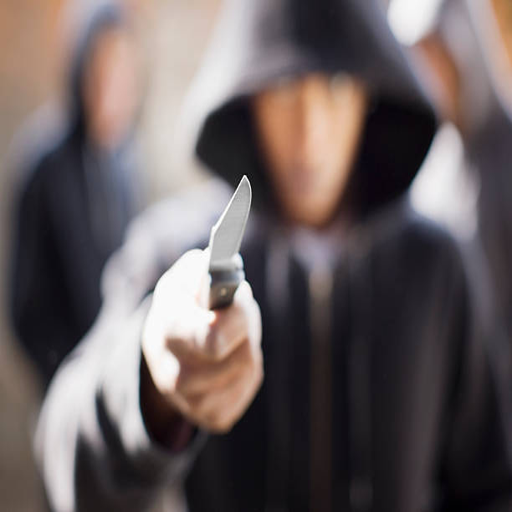

In [369]:
validation_weapon_image = (
    Image.open(requests.get(validation_url, stream=True).raw)
    .resize((512, 512))
    .convert("RGB")
)
validation_weapon_image

In [370]:
def make_weapon_gradcam_heatmap(img_tensor, path_to_saved_model):
    # Instantiate your DETR model
    num_classes = 6  # Change this to your desired number of classes
    num_queries = 100  # Change this to your desired number of queries

    # Use this for Experiment Baseline and 5
    # model = DETRModelWeapon(num_classes=num_classes, num_queries=num_queries)

    # Use this for Experiment 1 , 2 , 3 and 4
    model = DETRModelTuned(num_classes=num_classes, num_queries=num_queries)

    # Load the weights
    saved_detr_with_no_transformation_model_path = path_to_saved_model
    checkpoint = torch.load(
        saved_detr_with_no_transformation_model_path, map_location=torch.device("cpu")
    )
    model.load_state_dict(checkpoint)

    # Set the model to evaluation mode
    model.eval()

    # Perform the forward pass
    with torch.no_grad():
        output, _ = model(img_tensor)

    # Draw the Bounding Box on the Image
    drw = ImageDraw.Draw(validation_weapon_image)

    pred_logits = embed_output["pred_logits"][0][:, :7]
    pred_boxes = embed_output["pred_boxes"][0]

    max_output = pred_logits.softmax(-1).max(-1)
    topk = max_output.values.topk(1)

    pred_logits = pred_logits[topk.indices]
    pred_boxes = pred_boxes[topk.indices]

    for logits, box in zip(pred_logits, pred_boxes):
        cls = logits.argmax()
        if cls >= 7:  # len(class_names)
            continue
        box = box.cpu() * torch.Tensor([512, 512, 256, 256])
        x, y, w, h = box
        x0, x1 = x - w // 2, x + w // 2
        y0, y1 = y - h // 2, y + w // 2
        # It only takes the Top 1 , or the best prediction
        drw.rectangle([x0, y0, x1, y1], outline="red", width=5)

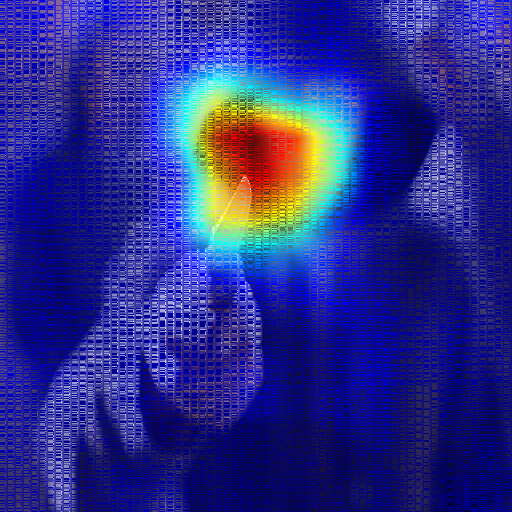

In [360]:
# Knife Object Grad Cam results
make_weapon_gradcam_heatmap(validation_weapon_image)

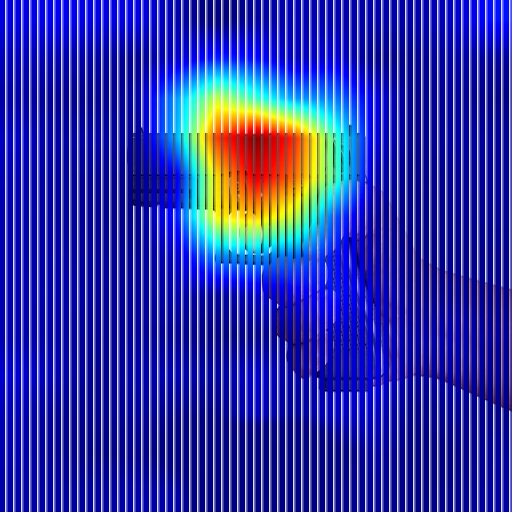

In [353]:
# Pistol Object Gradcam result
make_weapon_gradcam_heatmap()

#### Experiment with the different Models


In [371]:
# Assuming validation_image is a tensor of shape (B, C, H, W) with values in the range [0, 1]
validation_image_array = get_img_tensor(validation_weapon_image)
# Set one of the Models you would like to use here
# Experiment Base line
# model_to_use = "/content/drive/MyDrive/saved-models/detr_best_no_transformation.pth";

# Experiment 1
# model_to_use =  "/content/drive/MyDrive/saved-models/detr_best_with_transformations.pth"

# Experiment 2
# model_to_use = "/content/drive/MyDrive/saved-models/detr_best_with_transformations_fine_tuned.pth"

# Experiment 3
# model_to_use = "/content/drive/MyDrive/saved-models/detr_best_with_transformations_fine_tuned_experiment_3.pth"

# Experiment 4
model_to_use = "/content/drive/MyDrive/saved-models/detr_best_with_transformations_fine_tuned_experiment_4.pth"

# Experiment 5
# model_to_use = "/content/drive/MyDrive/saved-models/detr_best_with_transformations_fine_tuned_experiment_5.pth"

# Call the function with the validation_image tensor
make_weapon_gradcam_heatmap(validation_image_array, model_to_use)

Using cache found in /root/.cache/torch/hub/facebookresearch_detr_main


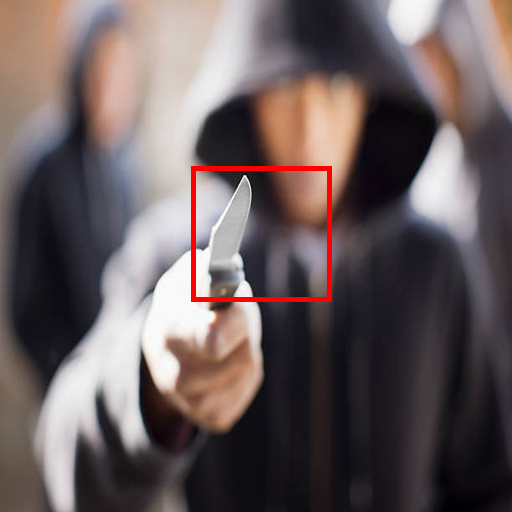

In [372]:
validation_weapon_image

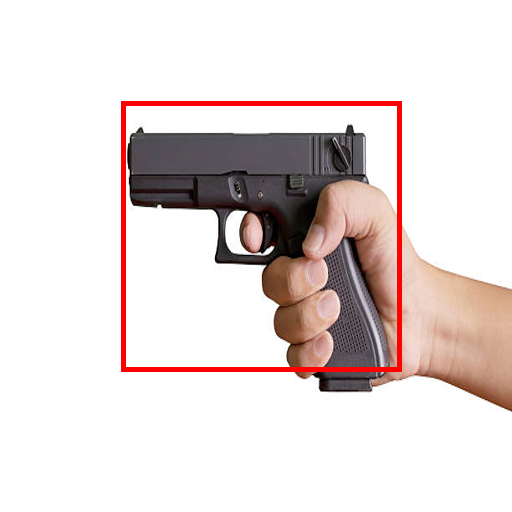

In [333]:
validation_weapon_image